# Peer-graded Assignment: Описательный анализ данных

Часто при работе с пользовательскими данными приходится сталкиваться с тем, что данные предоставляются для работы без описания. При этом не известно, что содержательно представляют собой те или иные признаки, а известны лишь их типы: числовые, категориальные, номинальные переменные. Такие ситуации - не редкость при работе с «чувствительными» данными, например, в сфере банковской аналитики, HR-аналитики, сфере телекоммуникаций, страхования, здравоохранения, недвижимости или ритейла. Тем не менее, с такими данным нужно уметь работать, и нужно уметь проводить на них классические этапы анализа, в частности описательный анализ данных и визуализацию. Именно этим мы займемся на первой неделе.


В этом задании мы потренируемся делать описательный анализ и визуализацию так называемых «закрытых» данных - данных, которые предоставляются для анализа и построения моделей без описания. Выборка, с которой мы будем работать прилагается.

* Метки классов (здесь `1` соответствует классу `отток`, `-1` - классу `не отток`) – `orange_small_churn_labels.train`
* Данные (предоставлены без описания, однако известно, что первые 190 переменных являются числовыми, а оставшиеся 40 - категориальными) – `orange_small_churn_data.train`

Скачайте эти файлы [на странице задания](https://www.coursera.org/learn/data-analysis-project/peer/roSOe/opisatiel-nyi-analiz-dannykh) и переходите к выполнению задачи! Результатом выполнения задания является jupyter notebook. Перед отправкой результата убедитесь, что вы выполнили все пункты из задания и это можно понять из вашего notebook'а. Проверьте, что код написан понятно и аккуратно - это поможет вашим сокурсником лучше понять, что вы сделали, и оценить вашу работу.

## Инструкции

1\. Загрузите данные `orange_small_churn_data.train` и `orange_small_churn_labels.train`

In [1]:
import warnings
warnings.filterwarnings('ignore')
import seaborn as sns
from matplotlib import pyplot as plt
sns.set_style("darkgrid")
import pandas as pd
import numpy as np
from scipy import stats
import itertools
import random

In [2]:
features = pd.read_csv('orange_small_churn_data.train')
labels = pd.read_csv('orange_small_churn_labels.train',header= None,names=['target'])
data = pd.concat([features,labels],axis=1)
data.head()

,Var1,Var2,Var3,Var4,Var5,Var6,Var7,Var8,Var9,Var10,...,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229,Var230,target
0,NaN,NaN,NaN,NaN,NaN,3052.0,NaN,NaN,NaN,NaN,...,vr93T2a,LM8l689qOp,NaN,NaN,fKCe,02N6s8f,xwM2aC7IdeMC0,NaN,NaN,-1
1,NaN,NaN,NaN,NaN,NaN,1813.0,7.0,NaN,NaN,NaN,...,6hQ9lNX,LM8l689qOp,NaN,ELof,xb3V,RAYp,55YFVY9,mj86,NaN,-1
2,NaN,NaN,NaN,NaN,NaN,1953.0,7.0,NaN,NaN,NaN,...,catzS2D,LM8l689qOp,NaN,NaN,FSa2,ZI9m,ib5G6X1eUxUn6,mj86,NaN,-1
3,NaN,NaN,NaN,NaN,NaN,1533.0,7.0,NaN,NaN,NaN,...,e4lqvY0,LM8l689qOp,NaN,NaN,xb3V,RAYp,F2FyR07IdsN7I,NaN,NaN,1
4,NaN,NaN,NaN,NaN,NaN,686.0,7.0,NaN,NaN,NaN,...,MAz3HNj,LM8l689qOp,NaN,NaN,WqMG,RAYp,F2FyR07IdsN7I,NaN,NaN,-1


2\. Рассчитайте доли классов `отток` и `не отток`.

In [3]:
print(f"Количество объектов: {data.shape[0]}")

Количество объектов: 40000


In [4]:
print(f'Доля класса "не отток": {(data.target==-1).mean()}')

Доля класса "не отток": 0.9256


In [5]:
print(f'Доля класса "отток": {(data.target==1).mean()}')

Доля класса "отток": 0.0744


Посмотрим на долю отсутствующих значений. Для этого построим вспомогательный датасет, а затем heat map, где желтым отмечены пропущенные значения.

In [6]:
data_to_heat = data.isnull()
data_to_heat.head()

,Var1,Var2,Var3,Var4,Var5,Var6,Var7,Var8,Var9,Var10,...,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229,Var230,target
0,True,True,True,True,True,False,True,True,True,True,...,False,False,True,True,False,False,False,True,True,False
1,True,True,True,True,True,False,False,True,True,True,...,False,False,True,False,False,False,False,False,True,False
2,True,True,True,True,True,False,False,True,True,True,...,False,False,True,True,False,False,False,False,True,False
3,True,True,True,True,True,False,False,True,True,True,...,False,False,True,True,False,False,False,True,True,False
4,True,True,True,True,True,False,False,True,True,True,...,False,False,True,True,False,False,False,True,True,False


Wall time: 8.28 s


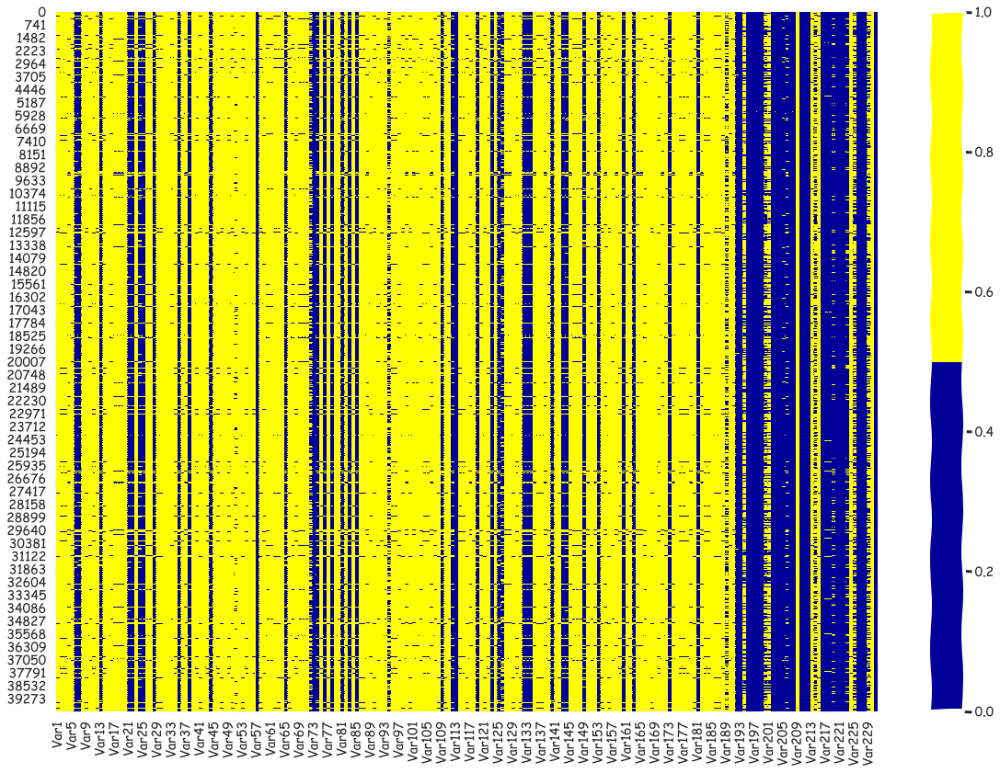

In [7]:
%%time
with plt.xkcd():
    plt.figure(figsize=(20,14))
    colors = ['#000099', '#ffff00'] 
    sns.heatmap(data_to_heat,cmap = sns.color_palette(colors));

Видно, что пропущенных значений намного больше, чем заполненных ячеек.

3\. Рассчитайте корреляции переменных с целевой функцией и проанализируйте полученные данные.

Обратите внимание на то, что целевая функция предсталвляет собой бинарную переменную. Теоретически, это не помешает рассчиать, например, корреляцию Пирсона между непрерывной переменной и целевой функцией, онднако анализиоовать полученные результаты будет сложно, корреляция Пирсона просто не рассчитана на такое применение. Кто уже забыл, как действовать в такой ситуации - вспоминить можно вот здесь: https://www.coursera.org/teach/stats-for-data-analysis/content/edit/lecture/prX3S/video-subtitles 

#### Исследуем данные, разделим признаки по группам

In [8]:
data.dtypes.value_counts()

float64    191
object      38
int64        2
dtype: int64

In [9]:
data_float = data.select_dtypes(include = ['float64']).copy()
data_float.head()

,Var1,Var2,Var3,Var4,Var5,Var6,Var7,Var8,Var9,Var10,...,Var183,Var184,Var185,Var186,Var187,Var188,Var189,Var190,Var209,Var230
0,NaN,NaN,NaN,NaN,NaN,3052.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,1813.0,7.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,276.0,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,1953.0,7.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,1533.0,7.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,686.0,7.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Разделим признаки по типам. Посмотрим на типы данных, рассмотрим тип float. Будем относить признаки с количеством уникальных значений меньше 20 к категориальным, остальные - к числовым. При этом совсем неинформативные признаки убираем из рассмотрения.

In [10]:
cols_float_cat = []
cols_float_num = []
for col in data_float.columns:
    len_unique = np.unique(data[col].dropna()).shape[0]
    if len_unique < 20:
        print(col)
        print(len_unique)
        print('--------')
        if len_unique > 1:
            cols_float_cat.append(col)
    else:
        cols_float_num.append(col) 
    

Var1
17
--------
Var2
2
--------
Var4
4
--------
Var7
6
--------
Var8
0
--------
Var11
4
--------
Var14
16
--------
Var15
0
--------
Var19
4
--------
Var20
0
--------
Var26
4
--------
Var27
2
--------
Var29
2
--------
Var30
13
--------
Var31
0
--------
Var32
0
--------
Var34
6
--------
Var35
12
--------
Var39
0
--------
Var42
0
--------
Var43
17
--------
Var44
8
--------
Var47
11
--------
Var48
0
--------
Var49
3
--------
Var52
0
--------
Var54
5
--------
Var55
0
--------
Var62
10
--------
Var65
13
--------
Var67
2
--------
Var72
8
--------
Var75
12
--------
Var78
13
--------
Var79
0
--------
Var82
4
--------
Var87
5
--------
Var89
15
--------
Var90
2
--------
Var93
4
--------
Var97
7
--------
Var100
5
--------
Var110
5
--------
Var116
2
--------
Var118
1
--------
Var122
3
--------
Var130
2
--------
Var132
18
--------
Var137
18
--------
Var138
2
--------
Var141
0
--------
Var142
4
--------
Var143
4
--------
Var144
10
--------
Var146
10
--------
Var147
5
--------
Var151
16
--------
Var1

Рассмотрим признак с типом данных int. 

In [11]:
data_int = data.select_dtypes(include=['int64']).copy()
data_int.head()

,Var73,target
0,34,-1
1,128,-1
2,166,-1
3,30,1
4,32,-1


In [12]:
np.unique(data_int.Var73).shape[0]

131

Отнесем данный признак к числовым признакам.

Рассмотрим признаки с типом данных object. 

In [13]:
data_not_num = data.select_dtypes(include=['object']).copy()
data_not_num.head()

,Var191,Var192,Var193,Var194,Var195,Var196,Var197,Var198,Var199,Var200,...,Var220,Var221,Var222,Var223,Var224,Var225,Var226,Var227,Var228,Var229
0,NaN,NESt0G8EIb,AERks4l,NaN,taul,1K8T,0LaQ,UaKK0yW,I1sFbv_0IT,NaN,...,hLKtJ9p,Al6ZaUT,vr93T2a,LM8l689qOp,NaN,NaN,fKCe,02N6s8f,xwM2aC7IdeMC0,NaN
1,NaN,P1WvyxLp3Z,2Knk1KF,NaN,taul,1K8T,YFAj,Bnunsla,o64y9zI,DlISMzi,...,hN8KpA1,oslk,6hQ9lNX,LM8l689qOp,NaN,ELof,xb3V,RAYp,55YFVY9,mj86
2,NaN,FoxgUHSK8h,LrdZy8QqgUfkVShG,NaN,taul,1K8T,TyGl,fhk21Ss,nQUveAzAF7,NaN,...,4UxGlow,zCkv,catzS2D,LM8l689qOp,NaN,NaN,FSa2,ZI9m,ib5G6X1eUxUn6,mj86
3,NaN,vNEvyxLp3Z,RO12,NaN,taul,1K8T,0Xwj,uoZk2Zj,LWyxgtXeJL,NaN,...,ylCK5YS,oslk,e4lqvY0,LM8l689qOp,NaN,NaN,xb3V,RAYp,F2FyR07IdsN7I,NaN
4,NaN,4e7gUH7IEC,RO12,NaN,taul,1K8T,vSNn,kugYdIL,ZIXKpoNpqq,NaN,...,PYpzAu9,oslk,MAz3HNj,LM8l689qOp,NaN,NaN,WqMG,RAYp,F2FyR07IdsN7I,NaN


Не будем рассмотривать неинформативные признаки.

In [14]:
cols_cat=[]
for col in data_not_num.columns.tolist():
    len_unique = np.unique(data[col].dropna()).shape[0]
    if len_unique > 1:
        cols_cat.append(col)
    else:
        print(col)
        print(len_unique)
        print('-------')    

Var191
1
-------
Var213
1
-------
Var215
1
-------
Var224
1
-------


In [15]:
data_cat=data[cols_cat+cols_float_cat]
data_cat.head()

,Var192,Var193,Var194,Var195,Var196,Var197,Var198,Var199,Var200,Var201,...,Var158,Var159,Var161,Var164,Var170,Var172,Var173,Var179,Var181,Var186
0,NESt0G8EIb,AERks4l,NaN,taul,1K8T,0LaQ,UaKK0yW,I1sFbv_0IT,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN
1,P1WvyxLp3Z,2Knk1KF,NaN,taul,1K8T,YFAj,Bnunsla,o64y9zI,DlISMzi,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN
2,FoxgUHSK8h,LrdZy8QqgUfkVShG,NaN,taul,1K8T,TyGl,fhk21Ss,nQUveAzAF7,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN
3,vNEvyxLp3Z,RO12,NaN,taul,1K8T,0Xwj,uoZk2Zj,LWyxgtXeJL,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN
4,4e7gUH7IEC,RO12,NaN,taul,1K8T,vSNn,kugYdIL,ZIXKpoNpqq,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,NaN,0.0,NaN


In [16]:
data_num = data[cols_float_num+['Var73']]
data_num.head()

,Var3,Var5,Var6,Var9,Var10,Var12,Var13,Var16,Var17,Var18,...,Var178,Var180,Var182,Var183,Var184,Var187,Var188,Var189,Var190,Var73
0,NaN,NaN,3052.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,34
1,NaN,NaN,1813.0,NaN,NaN,NaN,636.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,276.0,NaN,128
2,NaN,NaN,1953.0,NaN,NaN,NaN,448.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,166
3,NaN,NaN,1533.0,NaN,NaN,NaN,4.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,30
4,NaN,NaN,686.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,32


#### Подсчитаем меры корреляции числовых признаков и отклика как соответствующие разности условных математических ожиданий по классам. Считаем признак 73 тоже числовым, поскольку множество его значений имеет размер 131.

In [17]:
data_num_1 = data_num[data.target==1]
data_num_neg1 = data_num[data.target==-1]    

In [18]:
col_num = data_num.columns.tolist()
col_num

['Var3',
 'Var5',
 'Var6',
 'Var9',
 'Var10',
 'Var12',
 'Var13',
 'Var16',
 'Var17',
 'Var18',
 'Var21',
 'Var22',
 'Var23',
 'Var24',
 'Var25',
 'Var28',
 'Var33',
 'Var36',
 'Var37',
 'Var38',
 'Var40',
 'Var41',
 'Var45',
 'Var46',
 'Var50',
 'Var51',
 'Var53',
 'Var56',
 'Var57',
 'Var58',
 'Var59',
 'Var60',
 'Var61',
 'Var63',
 'Var64',
 'Var66',
 'Var68',
 'Var69',
 'Var70',
 'Var71',
 'Var74',
 'Var76',
 'Var77',
 'Var80',
 'Var81',
 'Var83',
 'Var84',
 'Var85',
 'Var86',
 'Var88',
 'Var91',
 'Var92',
 'Var94',
 'Var95',
 'Var96',
 'Var98',
 'Var99',
 'Var101',
 'Var102',
 'Var103',
 'Var104',
 'Var105',
 'Var106',
 'Var107',
 'Var108',
 'Var109',
 'Var111',
 'Var112',
 'Var113',
 'Var114',
 'Var115',
 'Var117',
 'Var119',
 'Var120',
 'Var121',
 'Var123',
 'Var124',
 'Var125',
 'Var126',
 'Var127',
 'Var128',
 'Var129',
 'Var131',
 'Var133',
 'Var134',
 'Var135',
 'Var136',
 'Var139',
 'Var140',
 'Var145',
 'Var148',
 'Var149',
 'Var150',
 'Var153',
 'Var154',
 'Var156',
 'Var

In [19]:
diff_E=[]
for col in col_num[:-1]:
    diff = abs(data_num_1[col].dropna().mean()-data_num_neg1[col].dropna().mean())/data_num[col].dropna().mean()
    diff_E.append(diff)
diff_E_df = pd.DataFrame(np.array(diff_E).reshape(1,len(diff_E)),columns=col_num[:-1])

In [20]:
diff_E_df_sorted = diff_E_df.sort_values(by=0,axis=1,ascending=False)
diff_E_df_sorted

,Var131,Var77,Var33,Var12,Var53,Var111,Var177,Var124,Var139,Var50,...,Var163,Var57,Var16,Var133,Var105,Var104,Var129,Var123,Var113,Var126
0,2.487346,0.830082,0.743291,0.70443,0.676657,0.652423,0.642579,0.547484,0.545154,0.518151,...,0.021557,0.007606,0.00583,0.005421,0.005205,0.005205,0.004923,0.001566,-1.055715,-9.135674


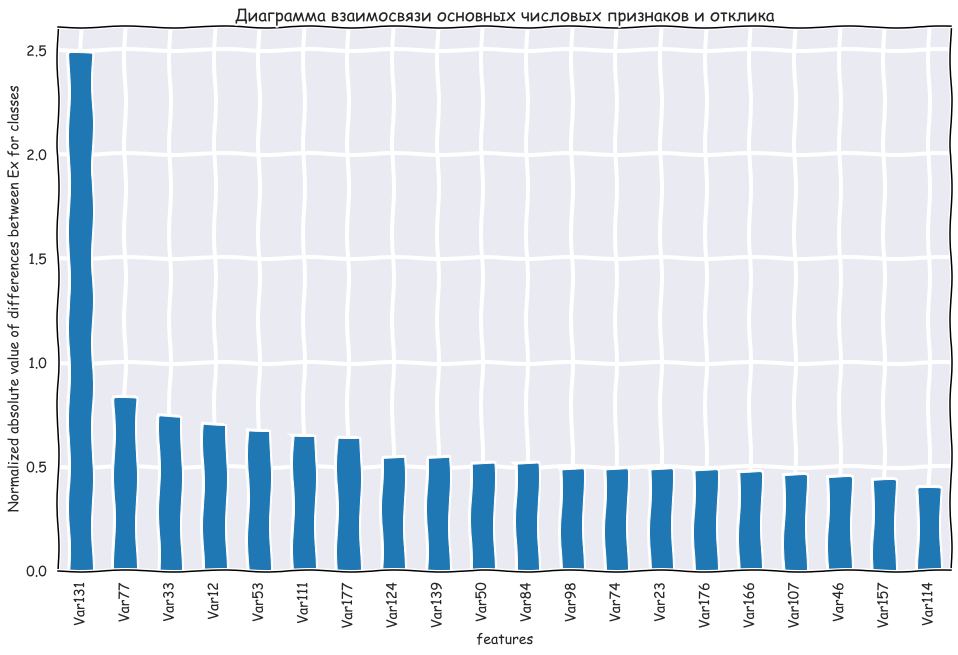

In [21]:
with plt.xkcd():
    plt.figure(figsize=(16,10))
    diff_E_df_sorted.iloc[0,:20].plot(kind='bar')
    plt.title('Диаграмма взаимосвязи основных числовых признаков и отклика')
    plt.ylabel('Normalized absolute value of differences between Ex for classes')
    plt.grid()
    plt.xlabel('features');

#### Теперь рассмотрим корреляцию категориальных переменных с откликом. Воспользуемся критерием хи квадрат и подсчитаем V Крамера.

In [22]:
col_cat = data_cat.columns
col_cat 

Index(['Var192', 'Var193', 'Var194', 'Var195', 'Var196', 'Var197', 'Var198',
       'Var199', 'Var200', 'Var201', 'Var202', 'Var203', 'Var204', 'Var205',
       'Var206', 'Var207', 'Var208', 'Var210', 'Var211', 'Var212', 'Var214',
       'Var216', 'Var217', 'Var218', 'Var219', 'Var220', 'Var221', 'Var222',
       'Var223', 'Var225', 'Var226', 'Var227', 'Var228', 'Var229', 'Var1',
       'Var2', 'Var4', 'Var7', 'Var11', 'Var14', 'Var19', 'Var26', 'Var27',
       'Var29', 'Var30', 'Var34', 'Var35', 'Var43', 'Var44', 'Var47', 'Var49',
       'Var54', 'Var62', 'Var65', 'Var67', 'Var72', 'Var75', 'Var78', 'Var82',
       'Var87', 'Var89', 'Var90', 'Var93', 'Var97', 'Var100', 'Var110',
       'Var116', 'Var122', 'Var130', 'Var132', 'Var137', 'Var138', 'Var142',
       'Var143', 'Var144', 'Var146', 'Var147', 'Var151', 'Var152', 'Var155',
       'Var158', 'Var159', 'Var161', 'Var164', 'Var170', 'Var172', 'Var173',
       'Var179', 'Var181', 'Var186'],
      dtype='object')

In [23]:
%%time
for col in col_cat:
    print(f'{col}: number of not NAN values for class 1 :{data[data.target==1][col].dropna().shape[0]},number of not NAN values for class -1:{data[data.target==-1][col].dropna().shape[0]}')
    print('-----------')

Var192: number of not NAN values for class 1 :2929,number of not NAN values for class -1:36780
-----------
Var193: number of not NAN values for class 1 :2976,number of not NAN values for class -1:37024
-----------
Var194: number of not NAN values for class 1 :678,number of not NAN values for class -1:9512
-----------
Var195: number of not NAN values for class 1 :2976,number of not NAN values for class -1:37024
-----------
Var196: number of not NAN values for class 1 :2976,number of not NAN values for class -1:37024
-----------
Var197: number of not NAN values for class 1 :2971,number of not NAN values for class -1:36906
-----------
Var198: number of not NAN values for class 1 :2976,number of not NAN values for class -1:37024
-----------
Var199: number of not NAN values for class 1 :2975,number of not NAN values for class -1:37021
-----------
Var200: number of not NAN values for class 1 :1182,number of not NAN values for class -1:18452
-----------
Var201: number of not NAN values for cl

Var158: number of not NAN values for class 1 :33,number of not NAN values for class -1:667
-----------
Var159: number of not NAN values for class 1 :41,number of not NAN values for class -1:965
-----------
Var161: number of not NAN values for class 1 :55,number of not NAN values for class -1:1220
-----------
Var164: number of not NAN values for class 1 :55,number of not NAN values for class -1:1220
-----------
Var170: number of not NAN values for class 1 :41,number of not NAN values for class -1:965
-----------
Var172: number of not NAN values for class 1 :56,number of not NAN values for class -1:1109
-----------
Var173: number of not NAN values for class 1 :2789,number of not NAN values for class -1:33195
-----------
Var179: number of not NAN values for class 1 :55,number of not NAN values for class -1:1220
-----------
Var181: number of not NAN values for class 1 :2789,number of not NAN values for class -1:33195
-----------
Var186: number of not NAN values for class 1 :35,number of no

Видно, что данных по классам по каждому из признаков много, попробуем применить сам критерий.

In [24]:
%%time
phi_Cs = []
p_vs = []
proportion_of_cells_below5 = []
for col in col_cat:
    ddf = pd.concat([data[col],data.target],axis=1).dropna()
    cross = pd.crosstab(ddf[col], ddf.target)
    chi2,p_v,_,expected_fr = stats.chi2_contingency(cross)
    print(col)
    below5=np.sum(expected_fr<5)/expected_fr.size
    print(f'Доля ячеек в таблице частот, где значение меньше 5: {below5}')
    print('--------')
    phi_c = np.sqrt(chi2/(sum(sum(cross.values))*(np.min([cross.shape[0],cross.shape[1]])-1)))
    phi_Cs.append(phi_c)
    p_vs.append(p_v)
    proportion_of_cells_below5.append(below5)

Var192
Доля ячеек в таблице частот, где значение меньше 5: 0.3644067796610169
--------
Var193
Доля ячеек в таблице частот, где значение меньше 5: 0.47
--------
Var194
Доля ячеек в таблице частот, где значение меньше 5: 0.16666666666666666
--------
Var195
Доля ячеек в таблице частот, где значение меньше 5: 0.5652173913043478
--------
Var196
Доля ячеек в таблице частот, где значение меньше 5: 0.375
--------
Var197
Доля ячеек в таблице частот, где значение меньше 5: 0.36818181818181817
--------
Var198
Доля ячеек в таблице частот, где значение меньше 5: 0.8481110254433307
--------
Var199
Доля ячеек в таблице частот, где значение меньше 5: 0.91375
--------
Var200
Доля ячеек в таблице частот, где значение меньше 5: 0.9978566593968564
--------
Var201
Доля ячеек в таблице частот, где значение меньше 5: 0.25
--------
Var202
Доля ячеек в таблице частот, где значение меньше 5: 0.7980873330927463
--------
Var203
Доля ячеек в таблице частот, где значение меньше 5: 0.4
--------
Var204
Доля ячеек в т

Видно, что есть много признаков, для которых в таблицах ожидаемых частот больше 20% ячеек со значениями меньше 5. Для таких признаков вышеуказанный критерий не применим. Ниже будут построены несколько диаграмм, на которых можно уведеть результаты применения критерия.

In [25]:
df_cat = pd.DataFrame([proportion_of_cells_below5,phi_Cs,p_vs,],columns=col_cat,index=['prop_below5','phi_c','p-value'])
df_cat
df_cat_sorted = df_cat.sort_values(by='phi_c',axis=1,ascending=False)
df_cat_sorted

,Var214,Var200,Var217,Var199,Var202,Var220,Var222,Var198,Var216,Var62,...,Var143,Var203,Var196,Var26,Var223,Var208,Var27,Var181,Var229,Var201
prop_below5,0.997857,0.997857,0.946953,9.137500e-01,0.798087,0.848111,0.848111,0.848111,0.861187,0.750000,...,0.375000,0.400000,0.375000,0.625000,0.000000,0.000000,0.250000,0.428571,0.250000,0.250000
phi_c,0.824051,0.824051,0.535147,4.078409e-01,0.363430,0.292593,0.292593,0.292593,0.228940,0.205436,...,0.012502,0.012308,0.012235,0.011472,0.010943,0.009324,0.007867,0.006823,0.005261,0.001636
p-value,0.409525,0.409525,1.000000,9.140718e-97,0.993472,1.000000,1.000000,1.000000,0.000005,0.020670,...,0.131408,0.196149,0.112200,0.984746,0.232048,0.062609,0.788295,0.947023,0.923965,0.868828


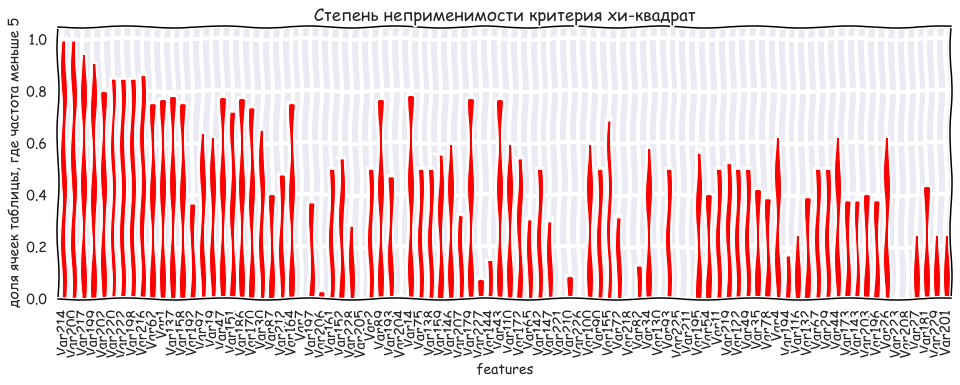

In [26]:
with plt.xkcd():
    plt.figure(figsize=(16,5))
    df_cat_sorted.loc['prop_below5'].plot(kind='bar',color = 'red')
    plt.title('Степень неприменимости критерия хи-квадрат')
    plt.ylabel('доля ячеек таблицы, где частота меньше 5')
    plt.grid()
    plt.xlabel('features');

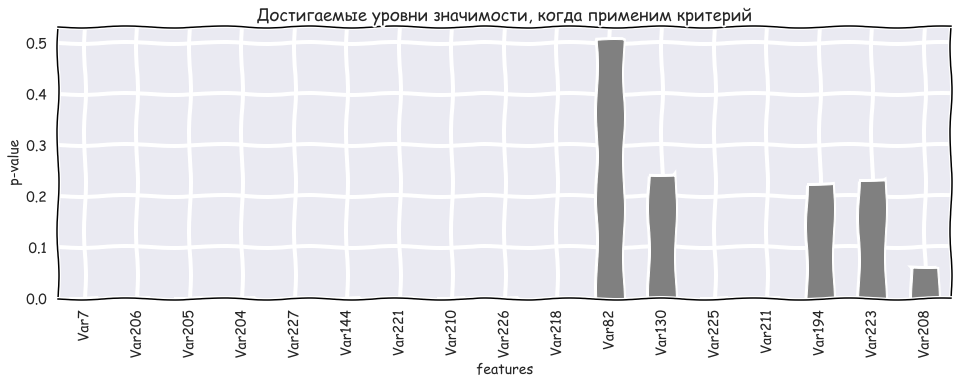

In [27]:
with plt.xkcd():
    plt.figure(figsize=(16,5))
    df_cat_sorted.loc['p-value'][df_cat_sorted.loc['prop_below5']<0.2].plot(kind='bar',color='grey')
    plt.title('Достигаемые уровни значимости, когда применим критерий')
    plt.ylabel('p-value')
    plt.grid()
    plt.xlabel('features');

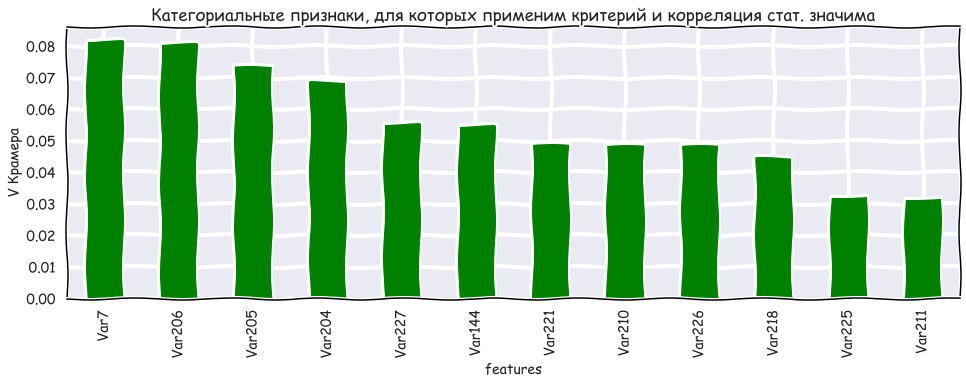

In [28]:
with plt.xkcd():
    plt.figure(figsize=(16,5))
    df_cat_sorted.loc['phi_c'][df_cat_sorted.loc['prop_below5']<0.2][df_cat_sorted.loc['p-value']<0.05].plot(kind='bar',color = 'green')
    plt.title('Категориальные признаки, для которых применим критерий и корреляция стат. значима')
    plt.ylabel('V Крамера')
    plt.grid()
    plt.xlabel('features');

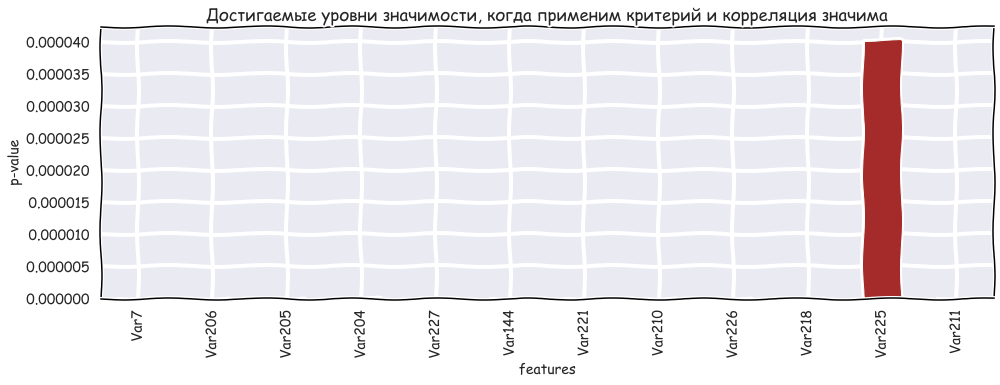

In [29]:
with plt.xkcd():
    plt.figure(figsize=(16,5))
    df_cat_sorted.loc['p-value'][df_cat_sorted.loc['prop_below5']<0.2][df_cat_sorted.loc['p-value']<0.05].plot(kind='bar',color='brown')
    plt.title('Достигаемые уровни значимости, когда применим критерий и корреляция значима')
    plt.ylabel('p-value')
    plt.grid()
    plt.xlabel('features');

В данной ситуации можно оценить сверху, как может повлиять поправка на множественную проверку гипотез. Воспользуемся методом Бонферони у домножим p-value на количество категориальных признаков (38) на максимальное значение p-value (4e-5). Получим величину намного меньше 0.05, то есть данная поправка ничего не меняет.

Можно заметить, что критерий хи-квадрат применим для небольшого количества признаков. Видно также, что даже даже статистически значимая по хи-квадрат корреляция, практически значима очень слабо. 

Значимость признаков для классификации будет оцениваться далее визуально с помощью гистограмм условных распределений признаков по классам.

4\. Визуализируйте данные: рассмотрите топ 20 числовых переменных, наиболее сильно коррелирующих с целевой функцией. Для этих переменных постройте:
* Распределения в разрезе классов
* Отобразите объекты в координатах пар признаков

Построим распределения признаков по классам.

In [30]:
color_dic={1:'red',-1:'blue'}
lbl_dic = {1:'отток',-1:'не отток'}

def two_hists(col,y,bins = None,nonzero=False,log=False,xlim = [0,0]):
    fe_name = col.name
    if xlim[1]==0 and xlim[0]==0:
        left = col.min()
        right = col.max()
    else:
        left = xlim[0]
        right = xlim[1]
    
    with plt.xkcd():
    
        fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 5))
        df = pd.DataFrame(np.vstack([col,y]).T,columns=[fe_name,'target'])    
        if nonzero:
            df=df[df[fe_name]>0]
        if log:
            df[fe_name] = df[fe_name].apply(lambda x: np.log(x+1))
        
        for idx, (cls, sub_df) in  enumerate(df.groupby('target')): 
            ax = axes[idx]
            if type(bins)==int:
                ax.hist(sub_df[fe_name],color = color_dic[cls],bins=bins)
            else:
                ax.hist(sub_df[fe_name],color = color_dic[cls])
            ax.set(xlabel=fe_name,ylabel='количество объектов')
            ax.set_xlim(left, right)
                
            ax.grid(True)
            ax.legend([lbl_dic[cls]])   
        

In [31]:
top_20_num_fe = diff_E_df_sorted.columns[:20].tolist()
top_20_num_fe

['Var131',
 'Var77',
 'Var33',
 'Var12',
 'Var53',
 'Var111',
 'Var177',
 'Var124',
 'Var139',
 'Var50',
 'Var84',
 'Var98',
 'Var74',
 'Var23',
 'Var176',
 'Var166',
 'Var107',
 'Var46',
 'Var157',
 'Var114']

Wall time: 1.47 s


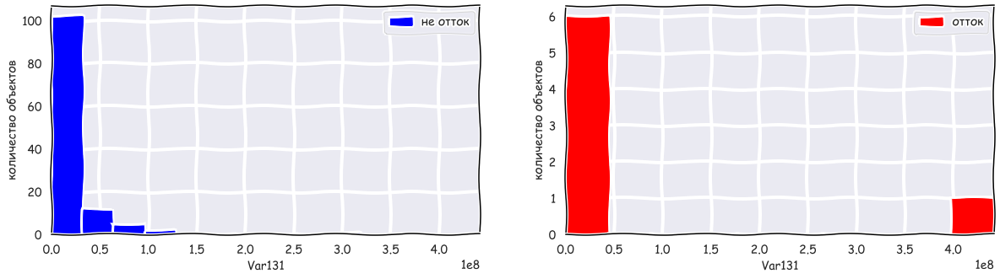

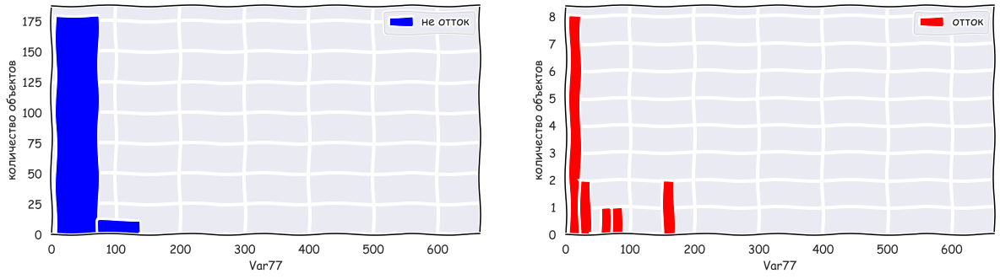

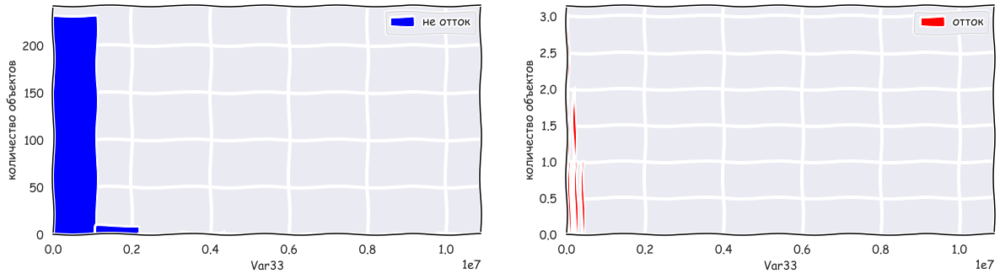

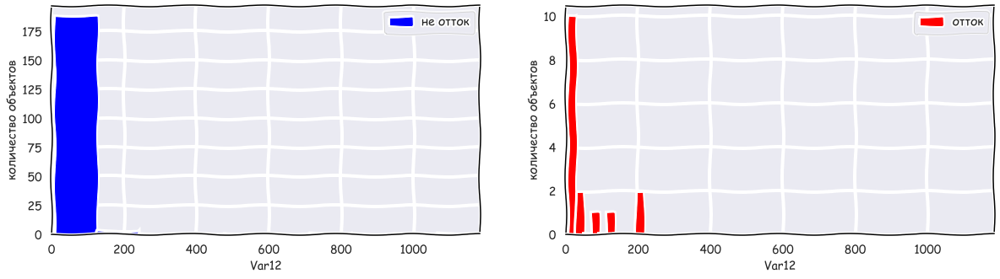

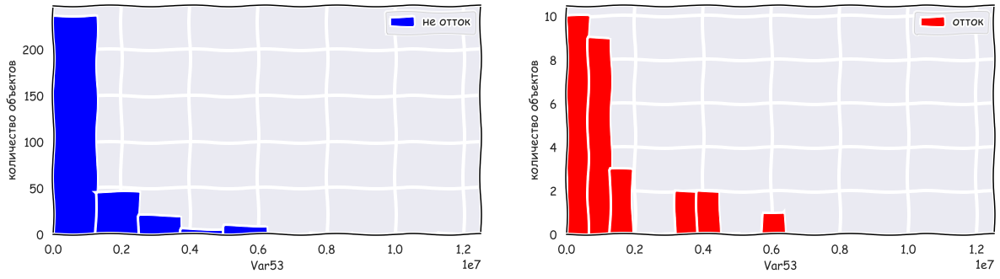

...

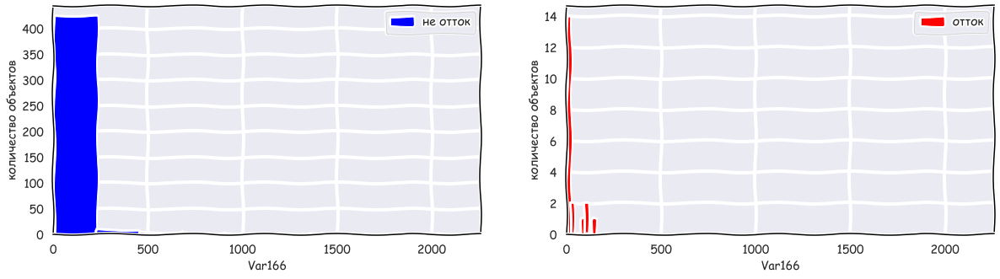

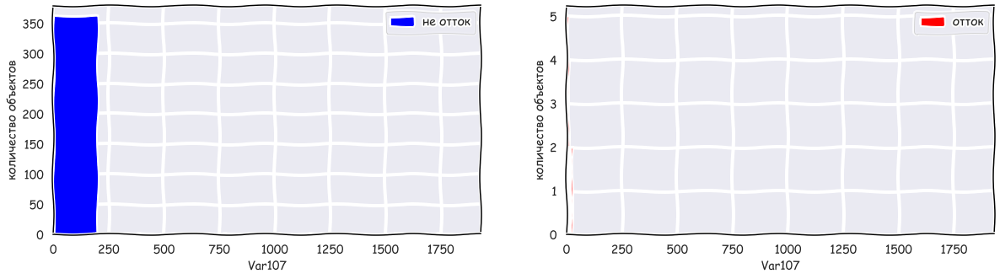

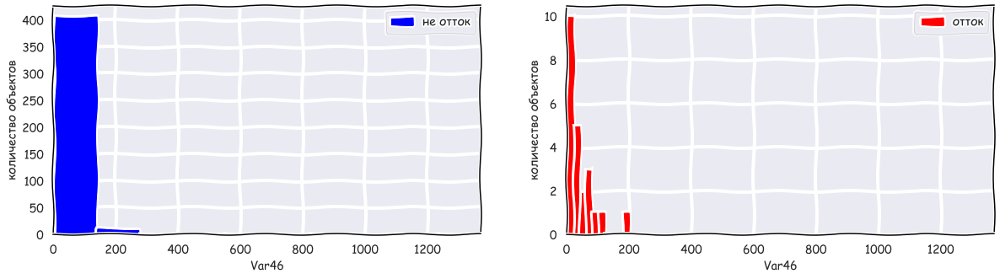

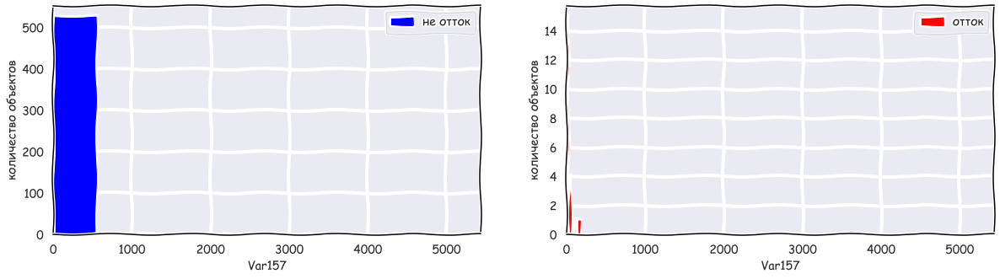

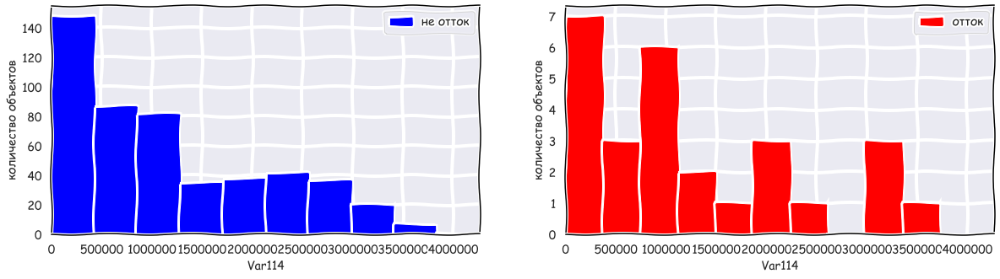

In [32]:
%%time
for col in top_20_num_fe:
    two_hists(data[col],data['target'],nonzero=True)

Из гистограмм можно заметить, что распределения варьируются по классам для всех 20 признаков, при этом распределения некоторых признаков похожи между собой (Var 131 и Var 50). Из анализа корреляций можно будет понять взаимосвязь признаков, тогда некоторые можно исключить из рассмотрения как неинформативные. Также ясно, что нужно проверить на меньшем масштабе признаки 157,107,166,23,74,33, поскольку разность математических ожиданий для разных классов настроилась на выборосы.

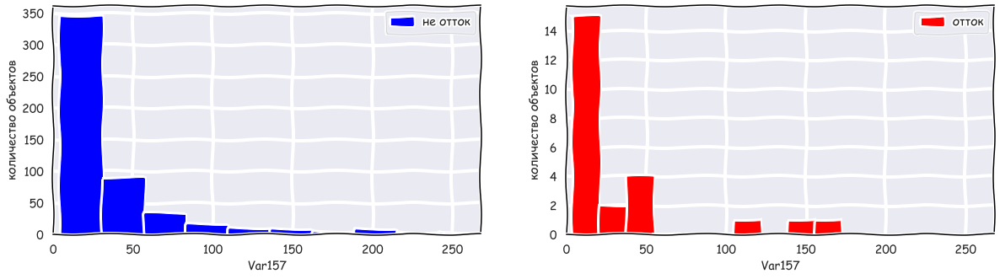

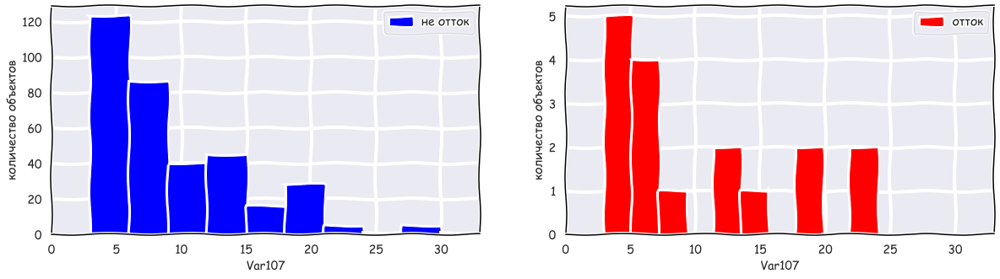

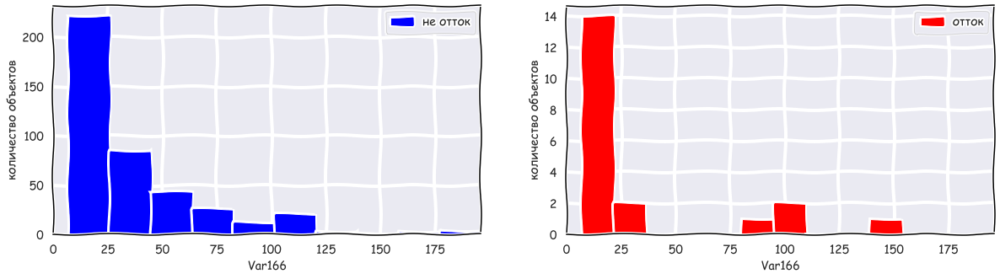

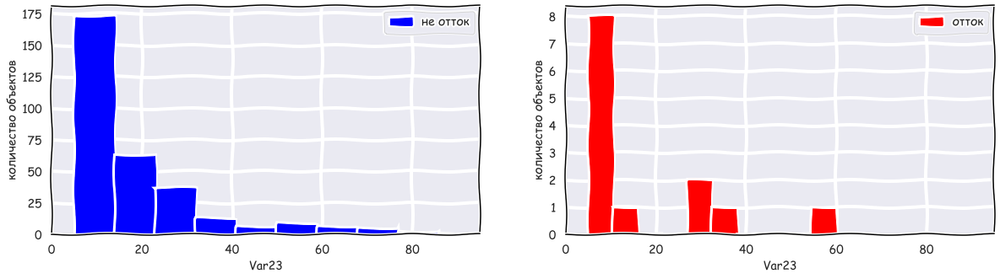

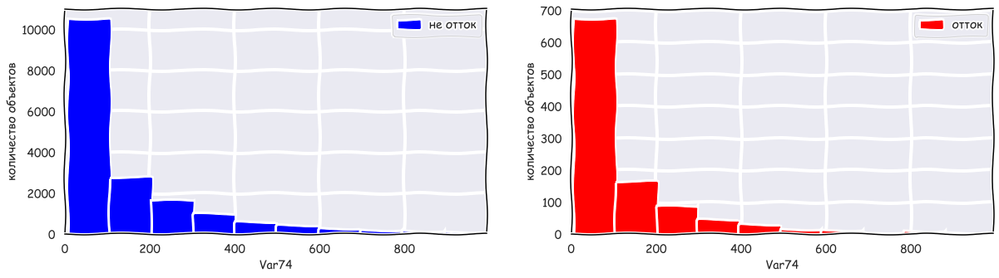

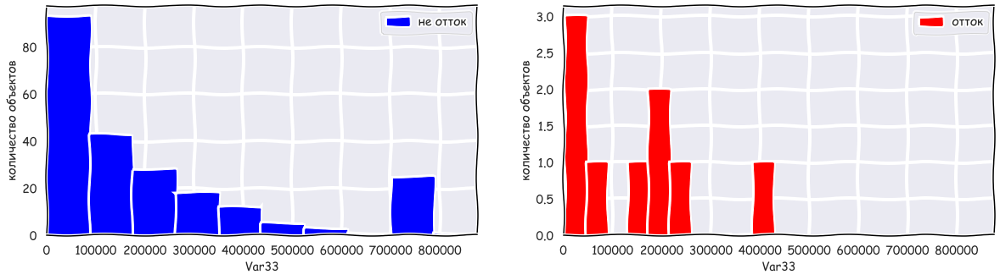

In [33]:
two_hists(data[data.Var157<300].Var157,data[data.Var157<300].target,nonzero=True)
two_hists(data[data.Var107<50].Var107,data[data.Var107<50].target,nonzero=True)
two_hists(data[data.Var166<200].Var166,data[data.Var166<200].target,nonzero=True)
two_hists(data[data.Var23<100].Var23,data[data.Var23<100].target,nonzero=True)
two_hists(data[data.Var74<1000].Var74,data[data.Var74<1000].target,nonzero=True)
two_hists(data[data.Var33<1e6].Var33,data[data.Var33<1e6].target,nonzero=True)

Видно, что признак 74, вероятно, бесполезен. 

Построим объекты в координатах пар признаков. Понятно, что если нет действительных пересечений, то построение невозможно.

In [34]:
def scatter_two_classes(fe1,fe2,y,log1=False,log2=False):   
    df = pd.concat([fe1,fe2,y],axis=1).dropna()
    if log1:
        df[df.columns.tolist()[0]]=df[df.columns.tolist()[0]].apply(lambda x: np.log(x+1))
    if log2:
        df[df.columns.tolist()[1]]=df[df.columns.tolist()[1]].apply(lambda x: np.log(x+1))
    
    if df.shape[0]>0:
    
        with plt.xkcd():
            plt.figure(figsize=(10,7))
            plt.grid()
            
            plt.xlabel(df.columns.tolist()[0])
            plt.ylabel(df.columns.tolist()[1])
            for (cls, sub_df) in  df.groupby('target'):         
                plt.scatter(sub_df.iloc[:,0],sub_df.iloc[:,1],c=color_dic[cls],label=lbl_dic[cls])
            plt.legend()
                
    else:
        print(f'{df.columns.tolist()[:2]}: No real objects in these coords!')
                

['Var131', 'Var33']: No real objects in these coords!
['Var131', 'Var111']: No real objects in these coords!
['Var131', 'Var177']: No real objects in these coords!
['Var131', 'Var124']: No real objects in these coords!
['Var131', 'Var139']: No real objects in these coords!
['Var131', 'Var84']: No real objects in these coords!
['Var131', 'Var74']: No real objects in these coords!
['Var131', 'Var23']: No real objects in these coords!
['Var131', 'Var176']: No real objects in these coords!
['Var131', 'Var166']: No real objects in these coords!
['Var131', 'Var107']: No real objects in these coords!
['Var131', 'Var46']: No real objects in these coords!
['Var131', 'Var157']: No real objects in these coords!
['Var131', 'Var114']: No real objects in these coords!
['Var77', 'Var33']: No real objects in these coords!
['Var77', 'Var111']: No real objects in these coords!
['Var77', 'Var177']: No real objects in these coords!
['Var77', 'Var124']: No real objects in these coords!
['Var77', 'Var139']:

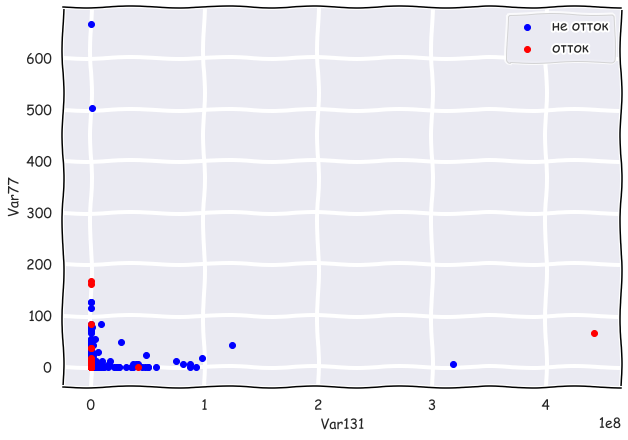

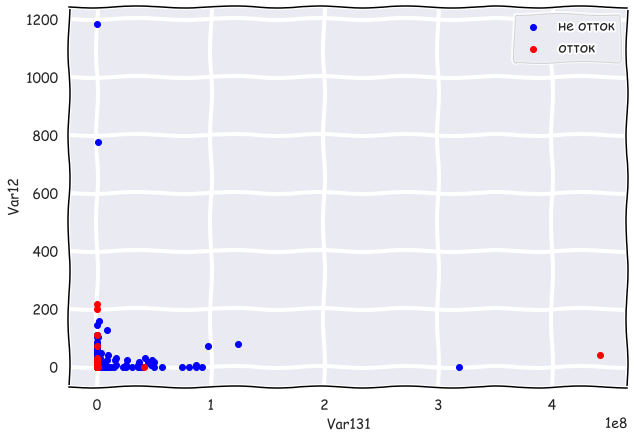

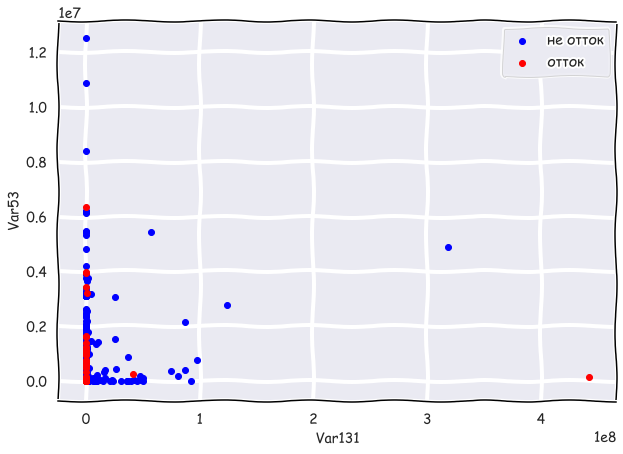

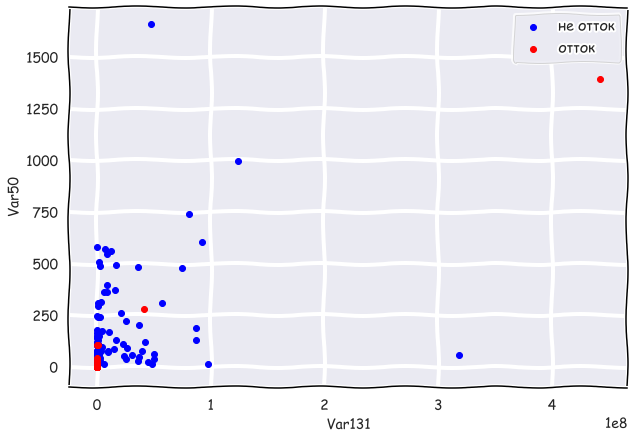

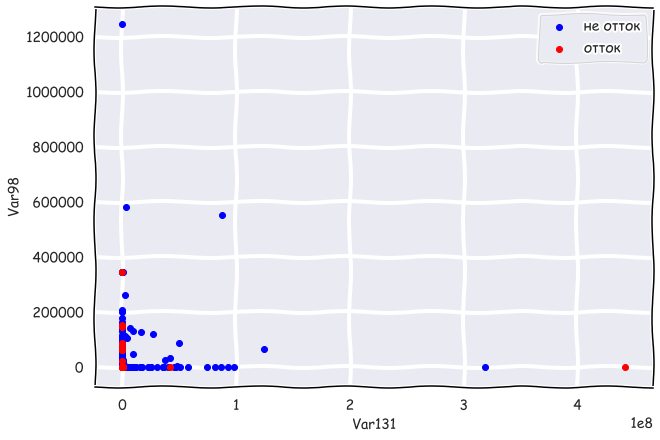

...

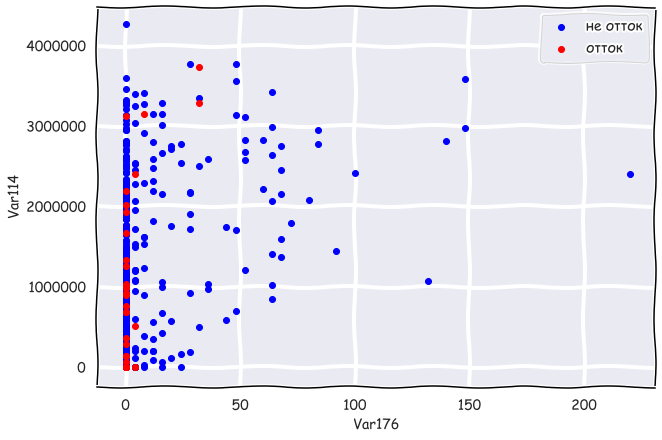

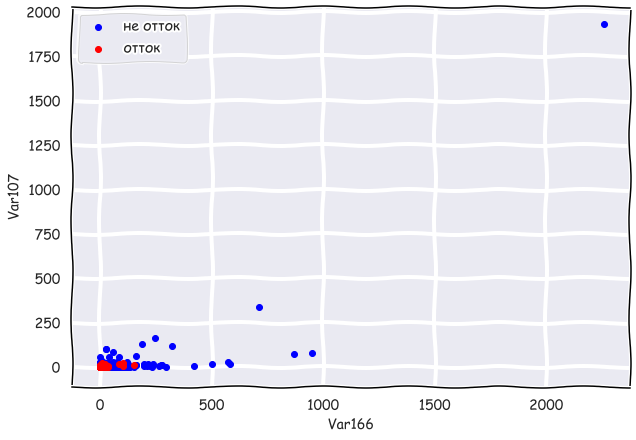

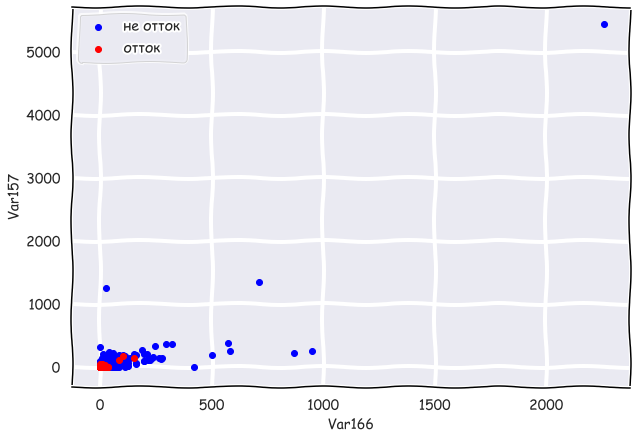

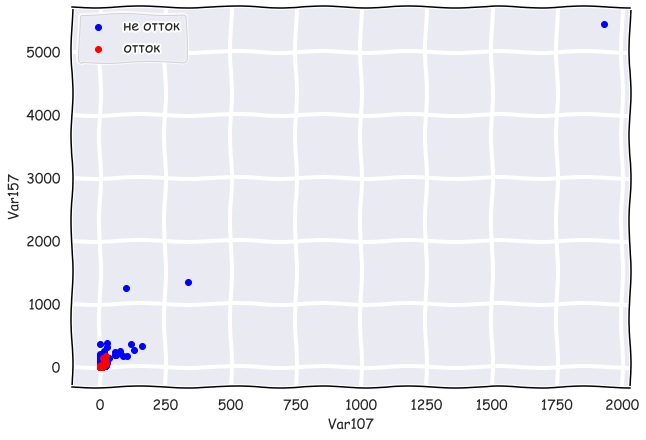

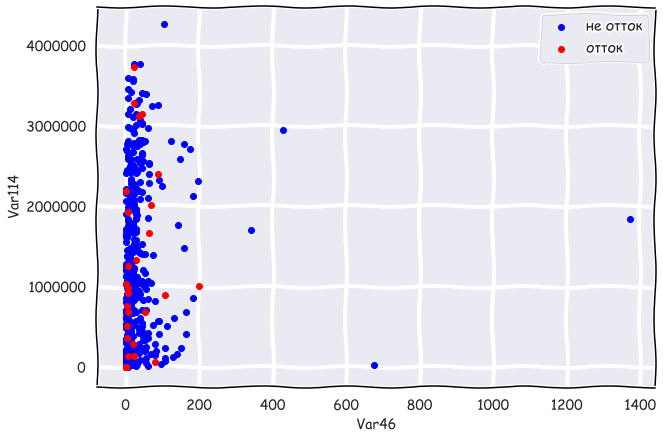

In [35]:
%%time
for (col1,col2) in itertools.combinations(top_20_num_fe,2):
    scatter_two_classes(fe1 = data[col1],fe2 = data[col2], y=data.target)

Можно заметить корреляцию, но мешают выбросы. Проверим корреляцию Пирсона.

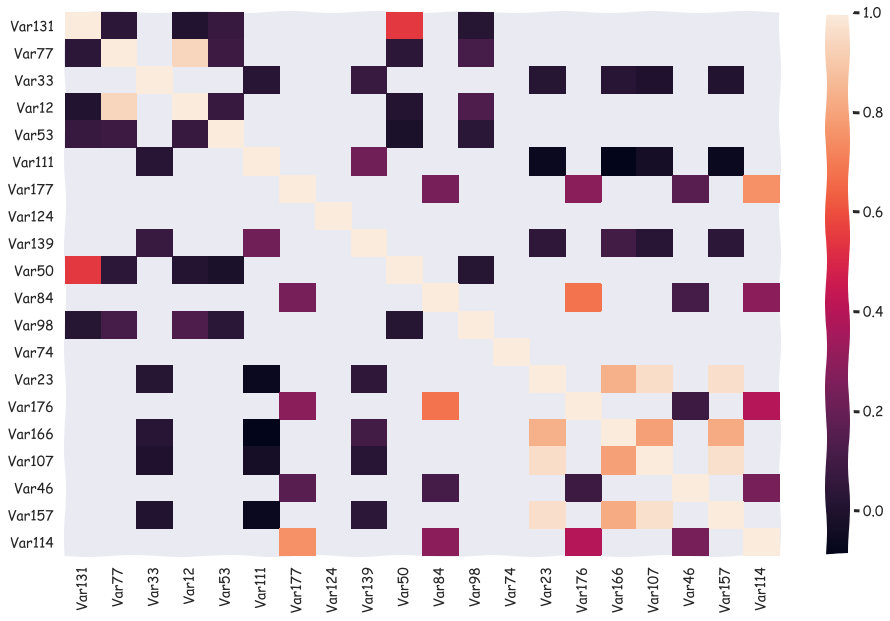

In [36]:
plt.figure(figsize=(16,10))
with plt.xkcd():
    sns.heatmap(data[top_20_num_fe].corr(method='pearson'));

Видно, что некоторые признаки скоррелированы. Попробуем перейти к логарифмированию, чтобы уменьшить влияние выбросов.

['Var131', 'Var33']: No real objects in these coords!
['Var131', 'Var111']: No real objects in these coords!
['Var131', 'Var177']: No real objects in these coords!
['Var131', 'Var124']: No real objects in these coords!
['Var131', 'Var139']: No real objects in these coords!
['Var131', 'Var84']: No real objects in these coords!
['Var131', 'Var74']: No real objects in these coords!
['Var131', 'Var23']: No real objects in these coords!
['Var131', 'Var176']: No real objects in these coords!
['Var131', 'Var166']: No real objects in these coords!
['Var131', 'Var107']: No real objects in these coords!
['Var131', 'Var46']: No real objects in these coords!
['Var131', 'Var157']: No real objects in these coords!
['Var131', 'Var114']: No real objects in these coords!
['Var77', 'Var33']: No real objects in these coords!
['Var77', 'Var111']: No real objects in these coords!
['Var77', 'Var177']: No real objects in these coords!
['Var77', 'Var124']: No real objects in these coords!
['Var77', 'Var139']:

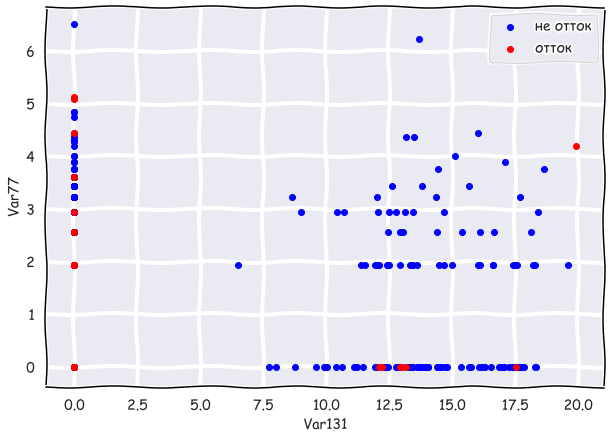

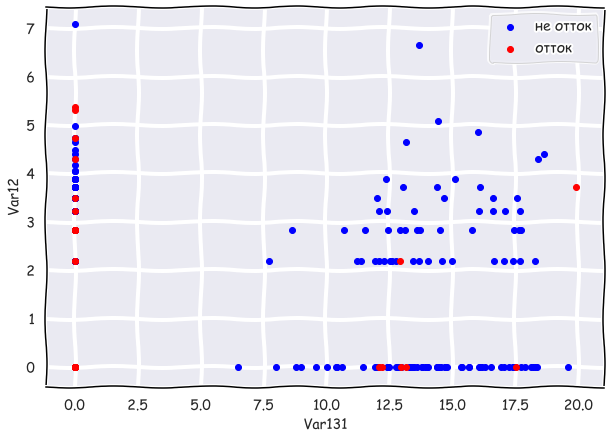

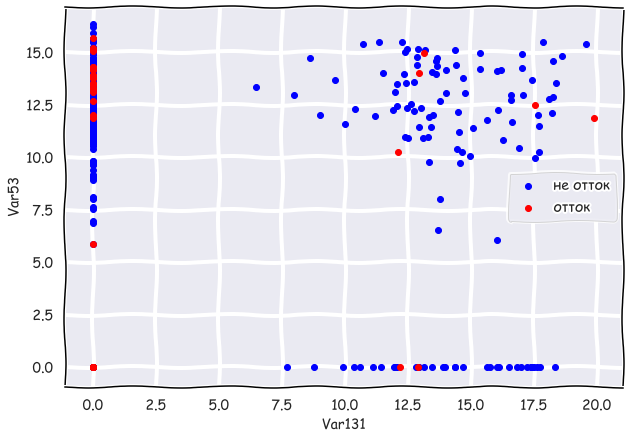

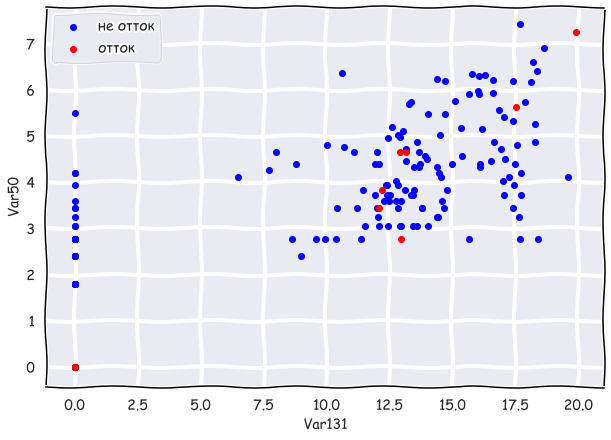

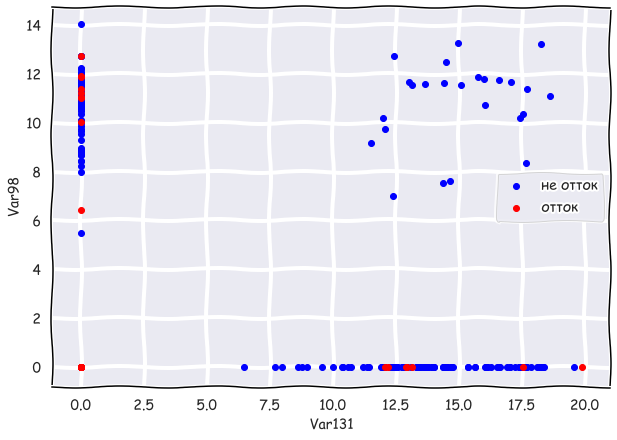

...

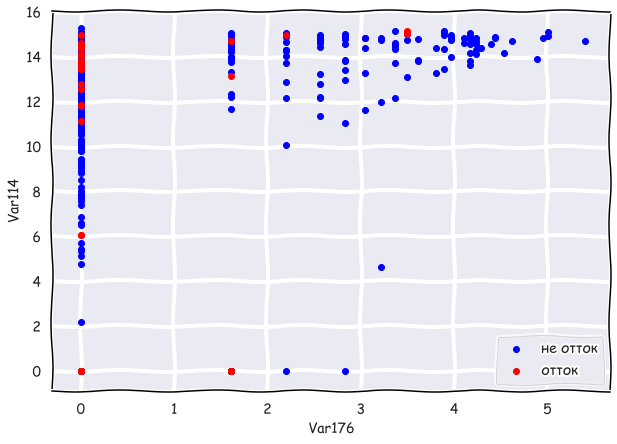

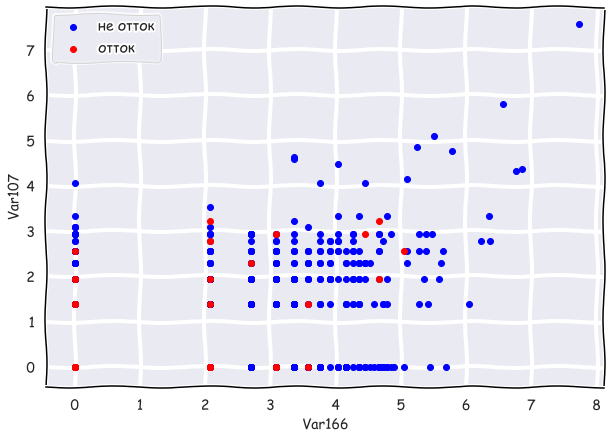

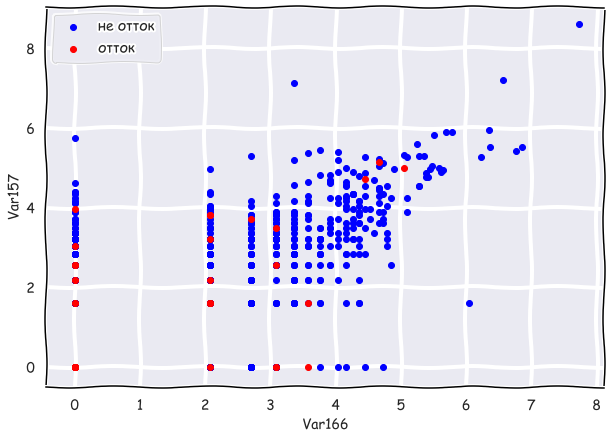

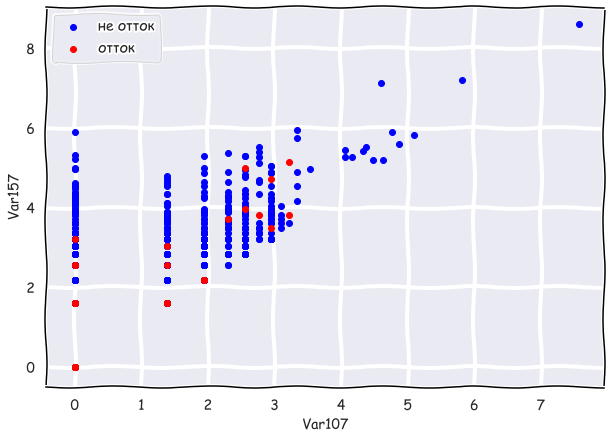

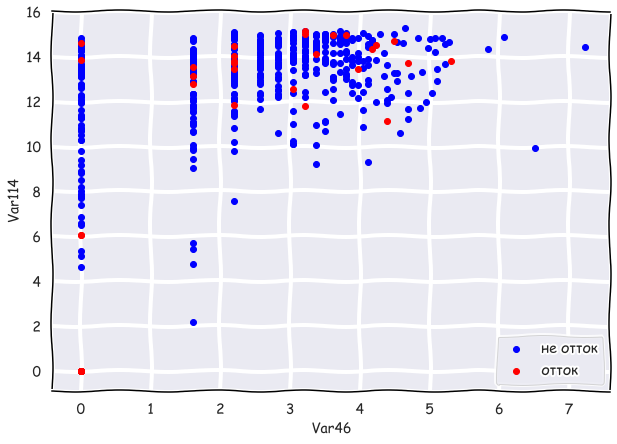

In [37]:
for (col1,col2) in itertools.combinations(top_20_num_fe,2):
    scatter_two_classes(fe1 = data[col1],fe2 = data[col2], y=data.target,log1=True,log2=True)

Корреляция более ярко выражена. Построим таблицу корреляции Спирмана.

Wall time: 460 ms


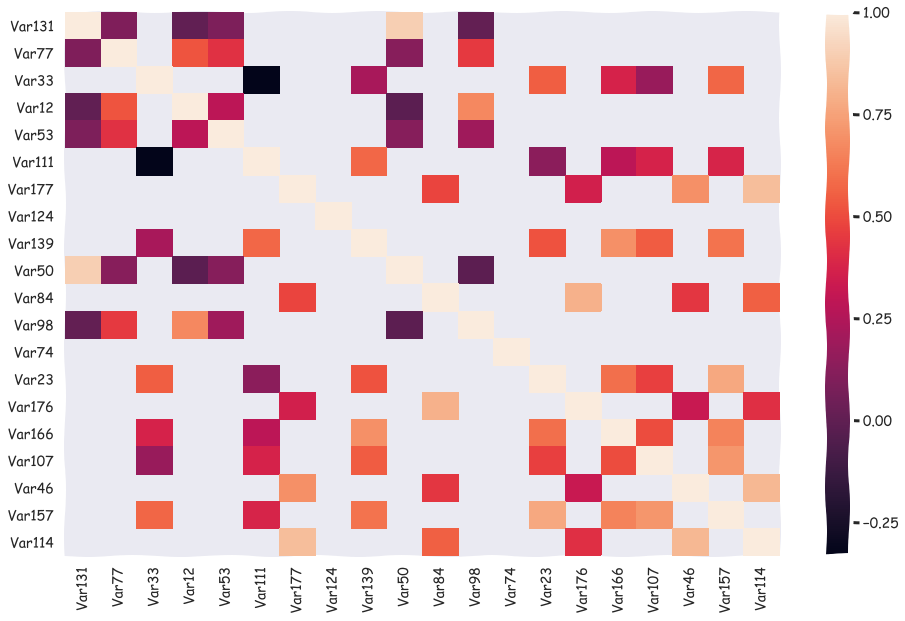

In [38]:
%%time
plt.figure(figsize=(16,10))
with plt.xkcd():
    sns.heatmap(data[top_20_num_fe].corr(method='spearman'));

Видна сильная корреляция признаков (131 и 50), (177 и 114), (23,107,157 и 166), (77 и 12).

Проверим наличие признаков, для которых количество уникальных значение соответствует количеству ненулевых

In [39]:
ind =0
for col in col_num:
    proportion = np.unique(data[col].dropna()).shape[0]/(data[col].dropna().shape[0])
    if proportion == 1:
        ind == 1
        print(f'Признак, где количество уникальных значений равно количеству ненулевых: {col}')
if ind == 0:
    print('Таких признаков нет')

Таких признаков нет


In [40]:
ind =0
for col in col_cat:
    proportion = np.unique(data[col].dropna()).shape[0]/(data[col].dropna().shape[0])
    if proportion == 1:
        ind == 1
        print(f'Признак, где количество уникальных значений равно количеству ненулевых: {col}')
if ind == 0:
    print('Таких признаков нет')

Таких признаков нет


Из анализа построенных диаграмм можно прийти к выводу о предположительной наибольшей полезности признаков 131,77, 124,177,98 из рассмотренных. При этом наименьшую полезность, вероятно, имеют признаки 74,23,107,157.

5\. Проделайте аналогичные шаги для случайно выбранных 10 числовых признаков.

Сгенерируем случайную подвыборку

In [41]:
random.seed(42)
smpl = random.sample(col_num,10)
smpl

['Var129',
 'Var25',
 'Var9',
 'Var154',
 'Var66',
 'Var60',
 'Var57',
 'Var36',
 'Var24',
 'Var136']

Проверим на дублирование с уже рассмотренными признаками

In [42]:
ind=0
for fe in smpl:
    if fe in top_20_num_fe:
        ind=1
        print(fe)
if ind==0:
    print('Совпадений нет')

Совпадений нет


Проделаем аналогичные предыдущему пункту шаги

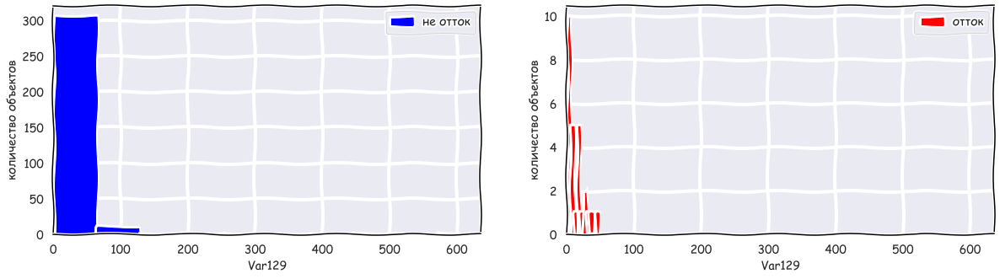

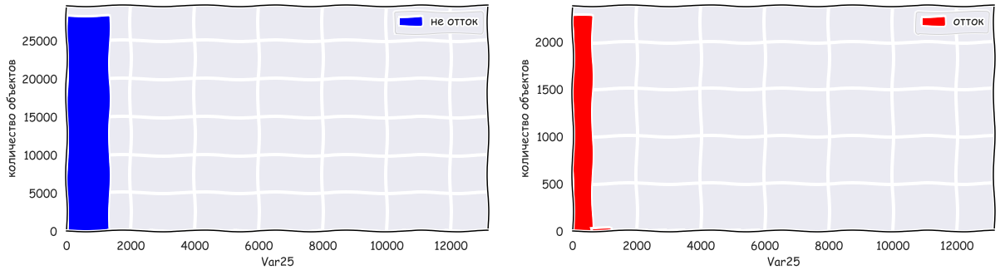

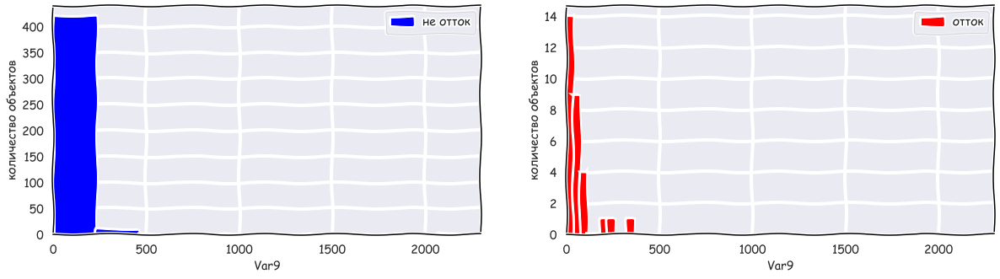

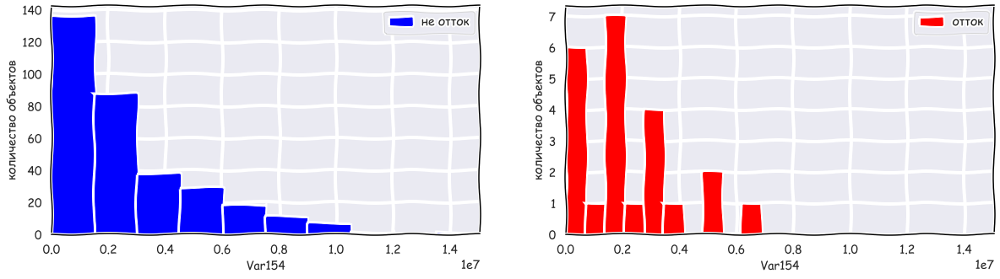

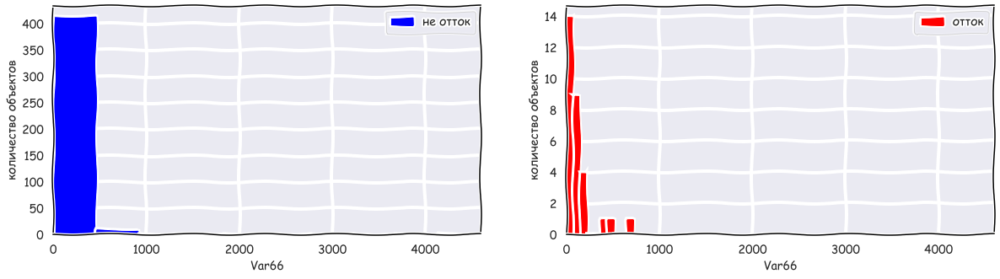

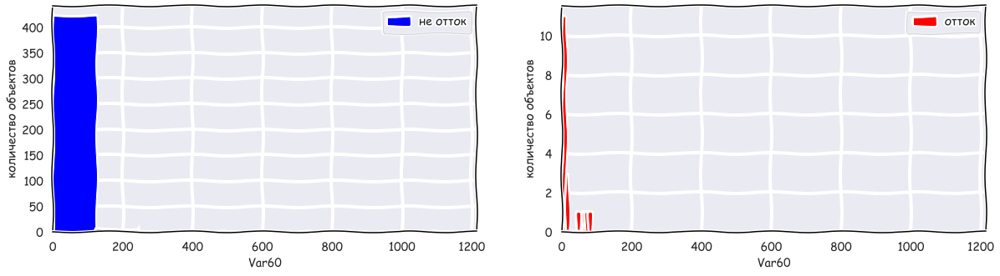

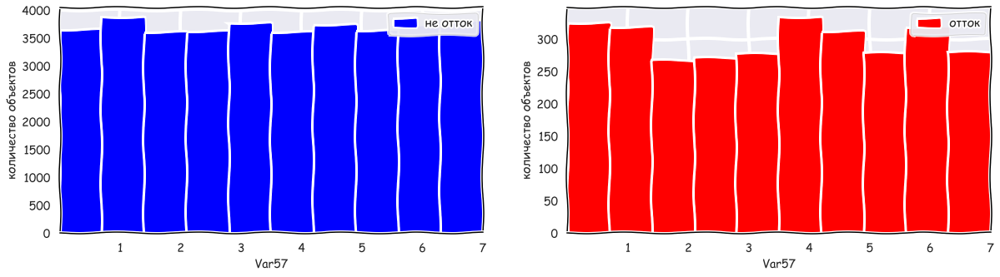

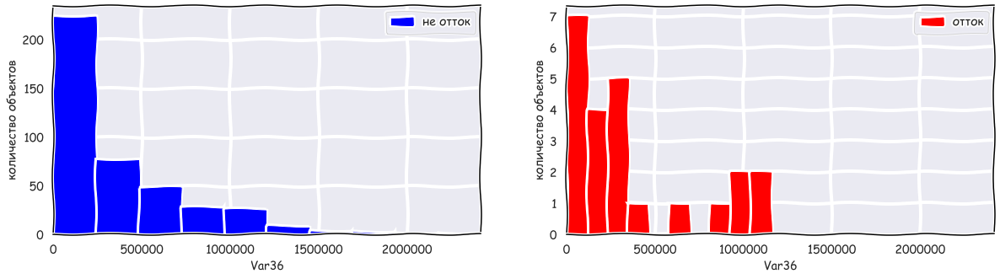

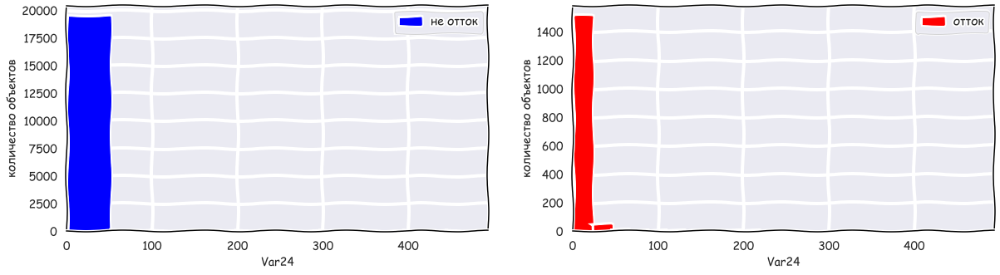

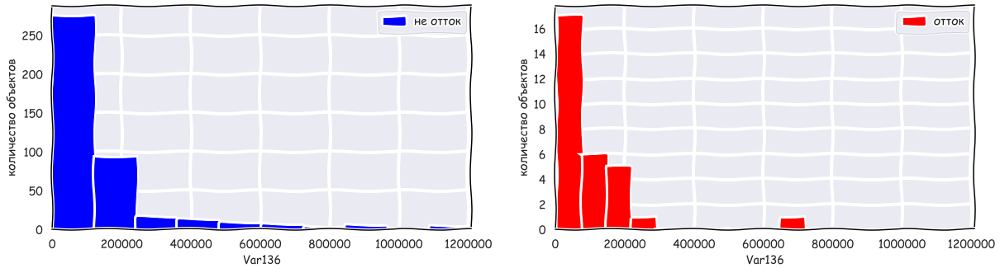

In [43]:
for col in smpl:
    two_hists(data[col],data['target'],nonzero=True)

Поскольку выборка случайная, среди признаков попадаются полезные (к примеру, признак 36). Посмотрим в другом масштабе на признаки 129, 25, 60,24

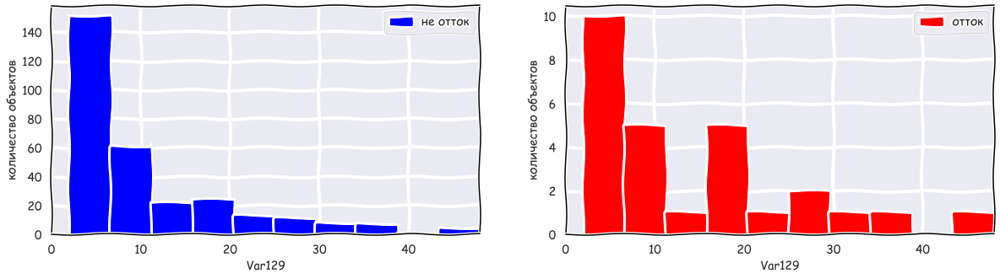

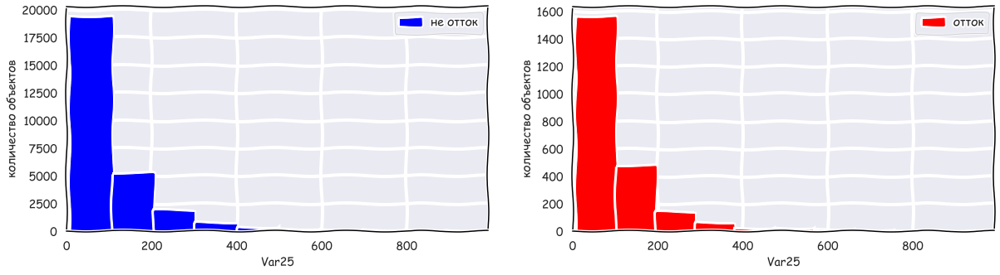

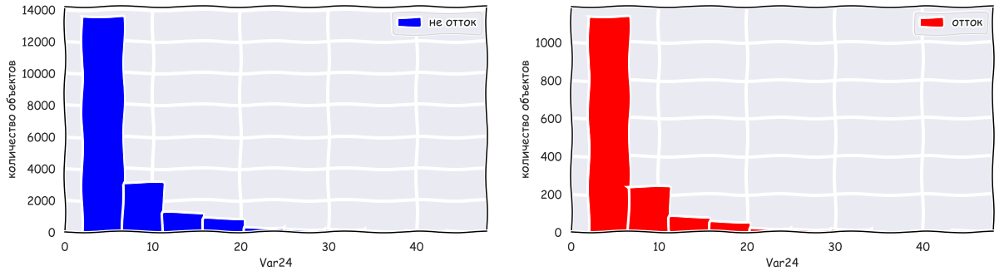

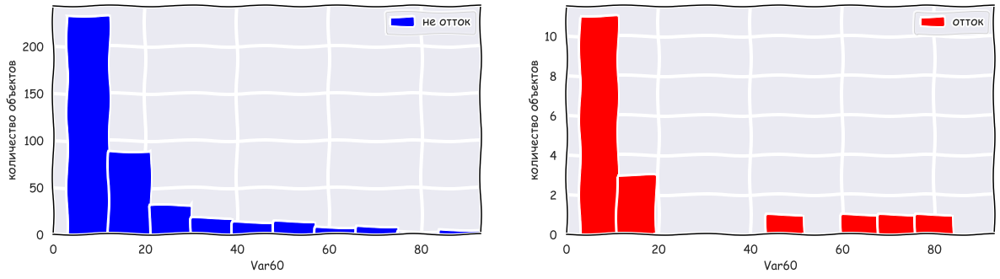

In [44]:
two_hists(data[data.Var129<50].Var129,data[data.Var129<50].target,nonzero=True)
two_hists(data[data.Var25<1000].Var25,data[data.Var25<1000].target,nonzero=True)
two_hists(data[data.Var24<50].Var24,data[data.Var24<50].target,nonzero=True)
two_hists(data[data.Var60<100].Var60,data[data.Var60<100].target,nonzero=True)

Видно, что признаки 24,25,вероятно, бесполезны и, при этом, коррелируют.

['Var129', 'Var25']: No real objects in these coords!
['Var129', 'Var60']: No real objects in these coords!
['Var129', 'Var36']: No real objects in these coords!
['Var129', 'Var24']: No real objects in these coords!
['Var25', 'Var9']: No real objects in these coords!
['Var25', 'Var154']: No real objects in these coords!
['Var25', 'Var66']: No real objects in these coords!
['Var25', 'Var60']: No real objects in these coords!
['Var25', 'Var36']: No real objects in these coords!
['Var25', 'Var136']: No real objects in these coords!
['Var9', 'Var60']: No real objects in these coords!
['Var9', 'Var36']: No real objects in these coords!
['Var9', 'Var24']: No real objects in these coords!
['Var154', 'Var60']: No real objects in these coords!
['Var154', 'Var36']: No real objects in these coords!
['Var154', 'Var24']: No real objects in these coords!
['Var66', 'Var60']: No real objects in these coords!
['Var66', 'Var36']: No real objects in these coords!
['Var66', 'Var24']: No real objects in th

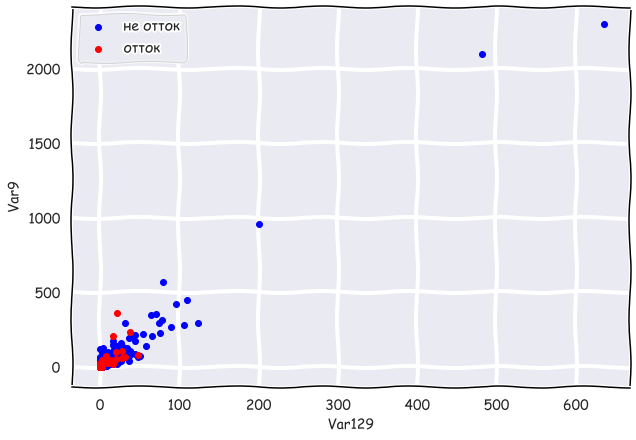

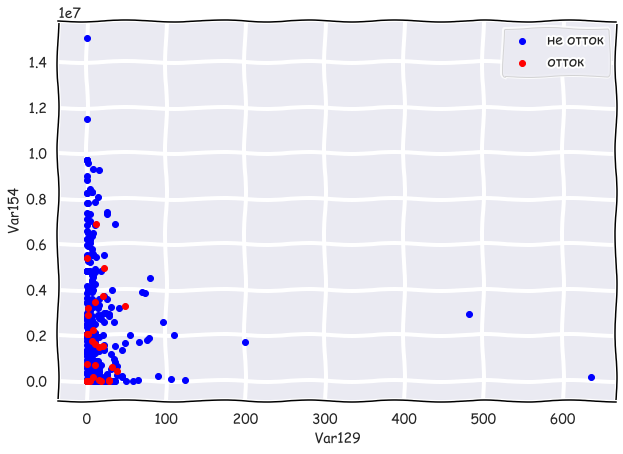

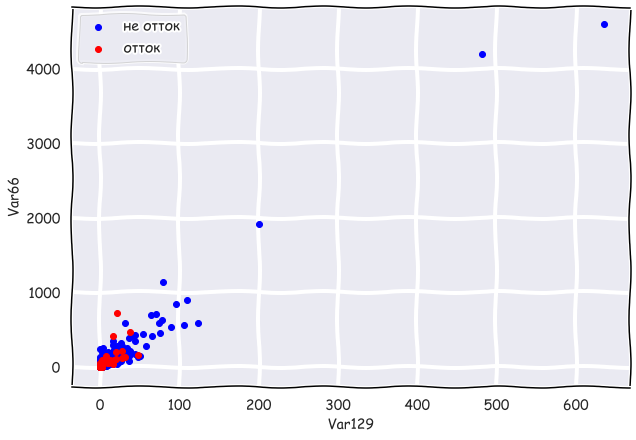

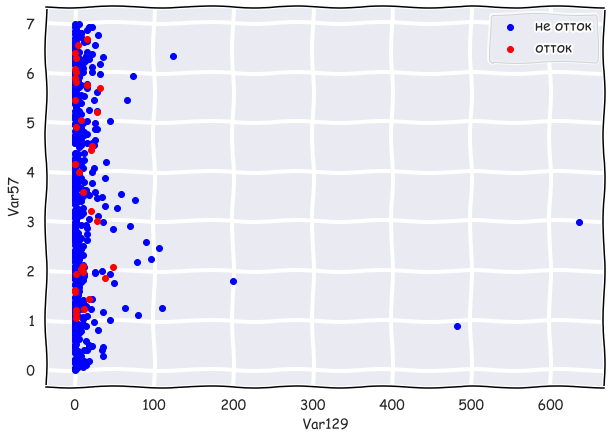

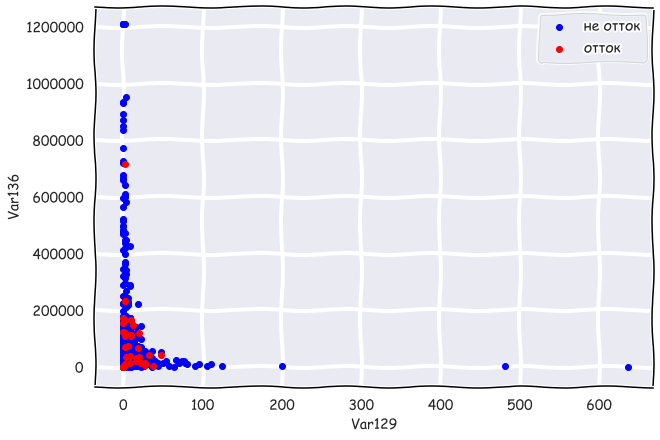

...

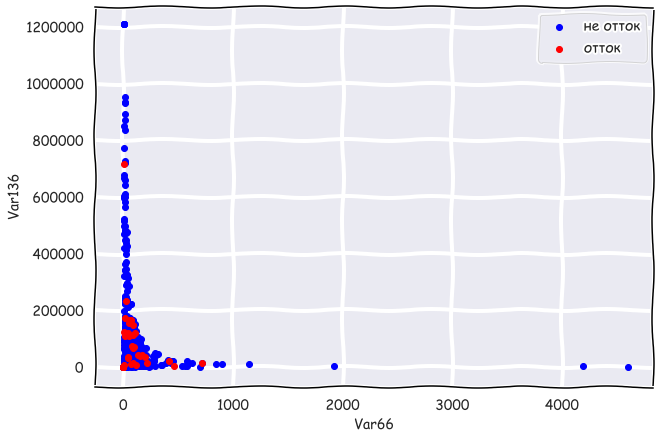

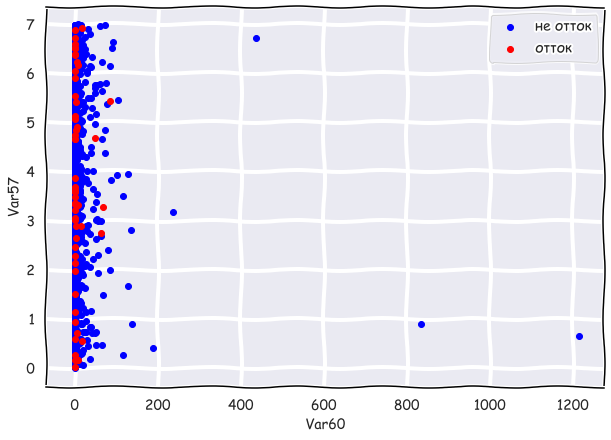

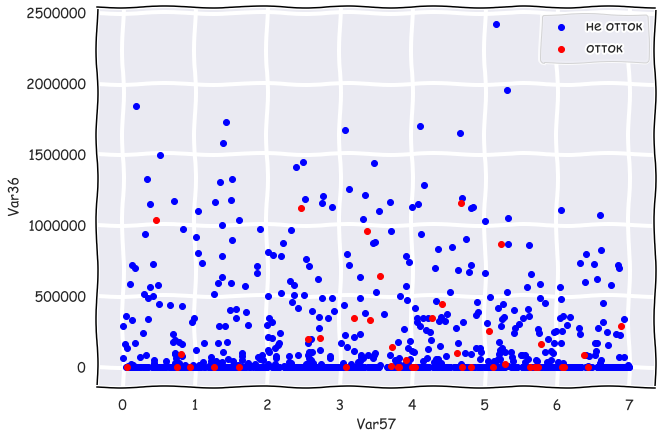

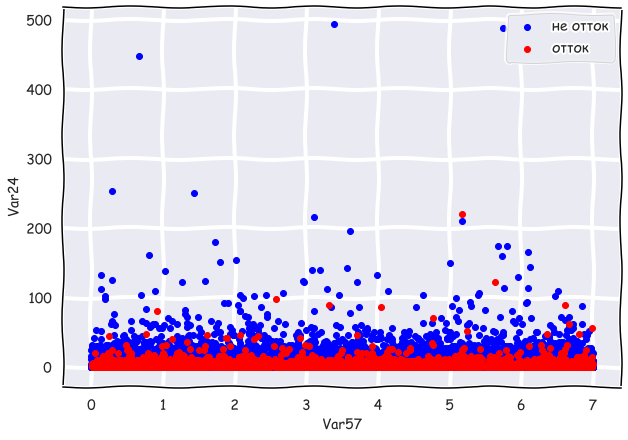

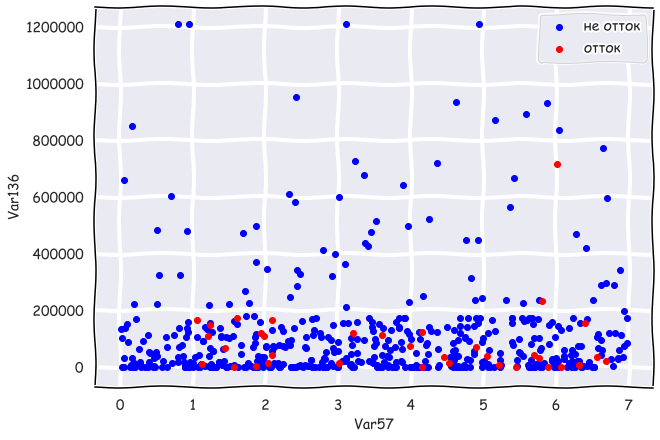

In [45]:
for (col1,col2) in itertools.combinations(smpl,2):
    scatter_two_classes(fe1 = data[col1],fe2 = data[col2], y=data.target)

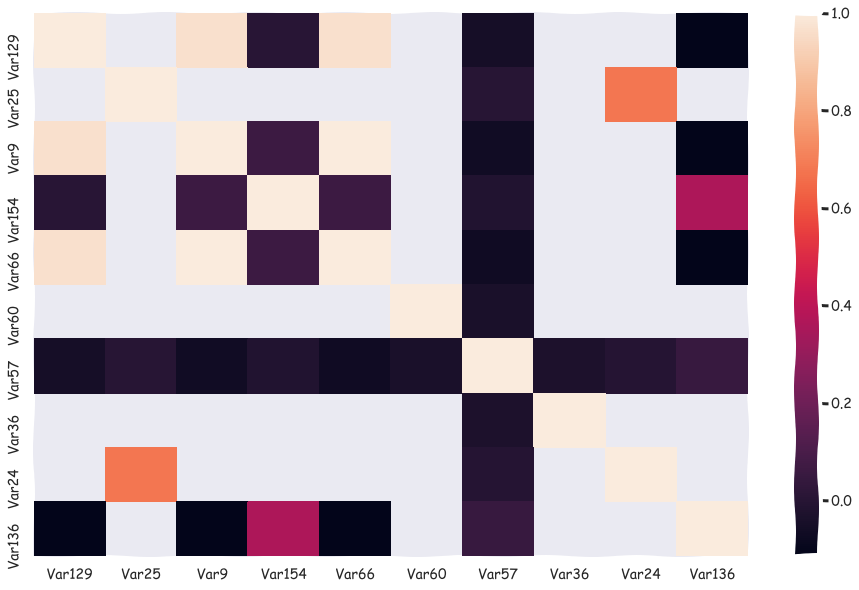

In [46]:
plt.figure(figsize=(16,10))
with plt.xkcd():
    sns.heatmap(data[smpl].corr(method='pearson'));

['Var129', 'Var25']: No real objects in these coords!
['Var129', 'Var60']: No real objects in these coords!
['Var129', 'Var36']: No real objects in these coords!
['Var129', 'Var24']: No real objects in these coords!
['Var25', 'Var9']: No real objects in these coords!
['Var25', 'Var154']: No real objects in these coords!
['Var25', 'Var66']: No real objects in these coords!
['Var25', 'Var60']: No real objects in these coords!
['Var25', 'Var36']: No real objects in these coords!
['Var25', 'Var136']: No real objects in these coords!
['Var9', 'Var60']: No real objects in these coords!
['Var9', 'Var36']: No real objects in these coords!
['Var9', 'Var24']: No real objects in these coords!
['Var154', 'Var60']: No real objects in these coords!
['Var154', 'Var36']: No real objects in these coords!
['Var154', 'Var24']: No real objects in these coords!
['Var66', 'Var60']: No real objects in these coords!
['Var66', 'Var36']: No real objects in these coords!
['Var66', 'Var24']: No real objects in th

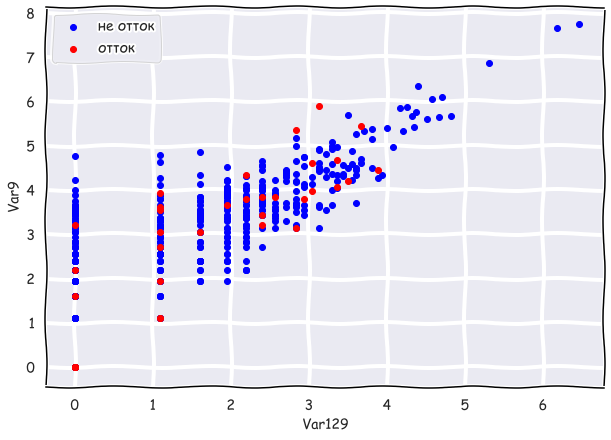

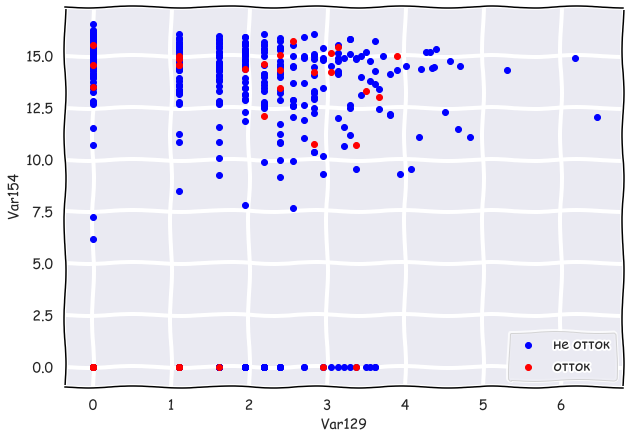

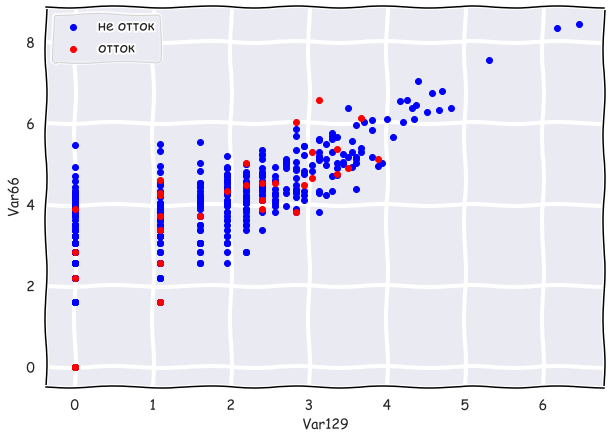

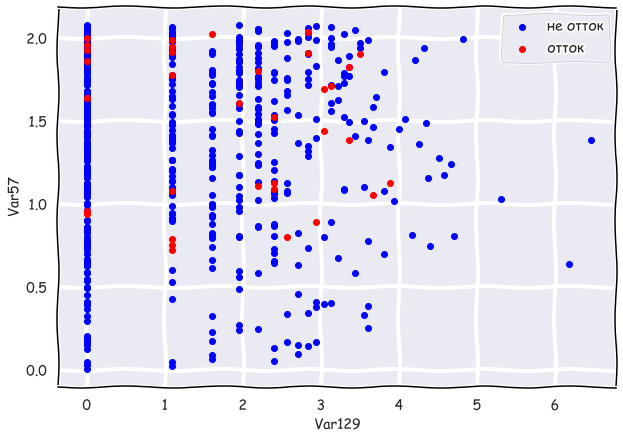

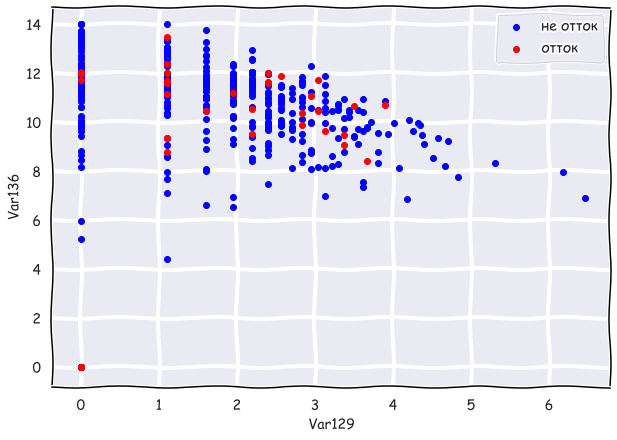

...

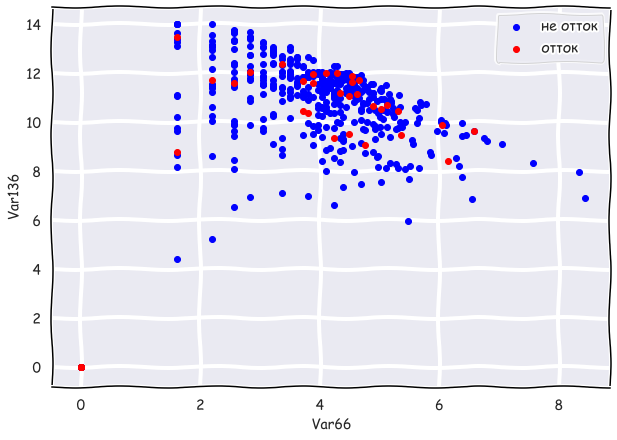

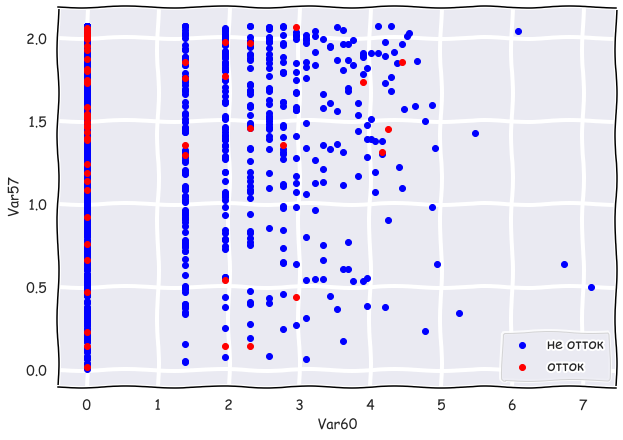

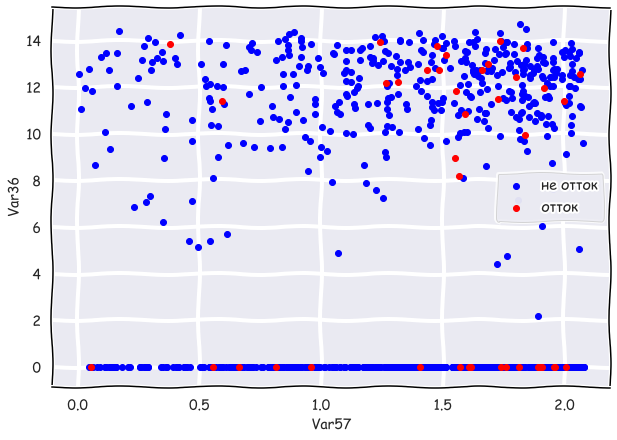

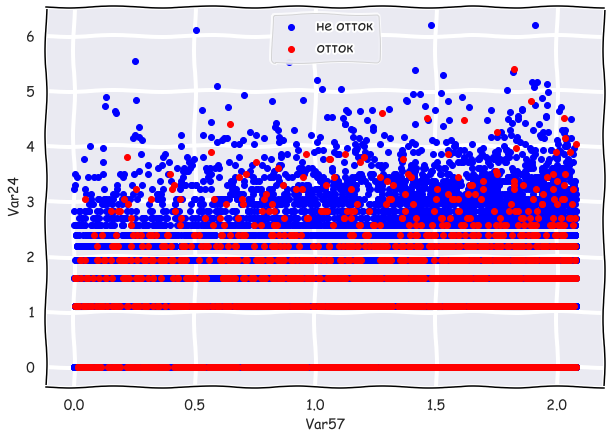

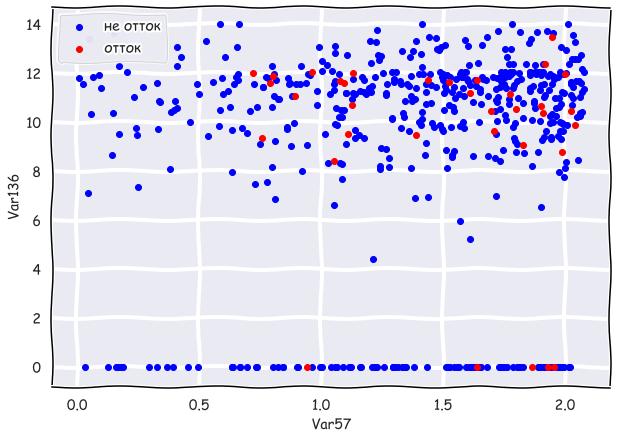

In [47]:
for (col1,col2) in itertools.combinations(smpl,2):
    scatter_two_classes(fe1 = data[col1],fe2 = data[col2], y=data.target,log1=True,log2=True)

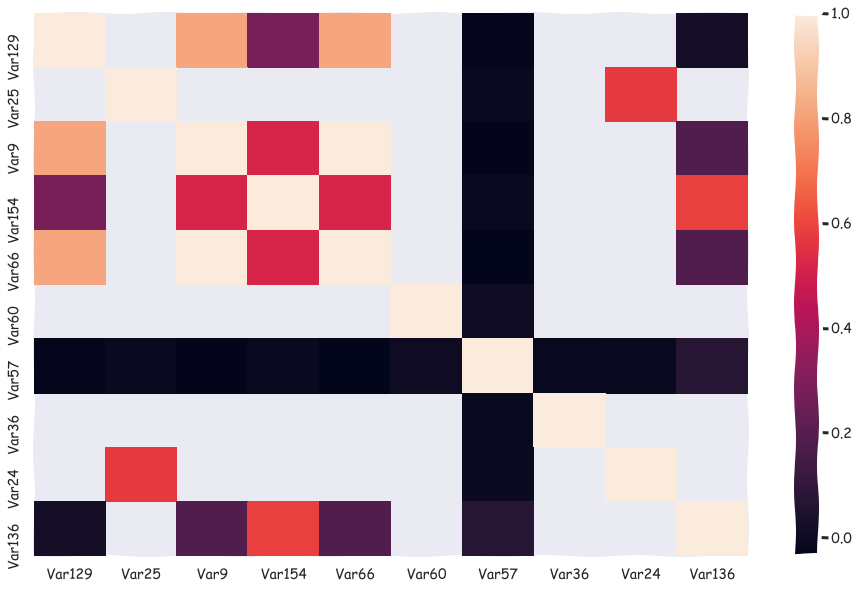

In [48]:
plt.figure(figsize=(16,10))
with plt.xkcd():
    sns.heatmap(data[smpl].corr(method='spearman'));

Из анализа корреляций видны множественные корреляции, а также вероятные совпадения признаков (129, 66, 9). Отметим, что признаки (24,25) и (136,154) коррелируют, хотя и меньше.

Вероятно, наиболее полезными из рассмотренных признаков являются 154, 36, а бесполезными - 57,24,25.

6\. Проделайте аналогичные шаги для 10 числовых признаков, наименее сильно коррелирующих с целевой переменной.

In [49]:
least_important_10_num_fe = diff_E_df_sorted.columns[-10:].tolist()
least_important_10_num_fe

['Var163',
 'Var57',
 'Var16',
 'Var133',
 'Var105',
 'Var104',
 'Var129',
 'Var123',
 'Var113',
 'Var126']

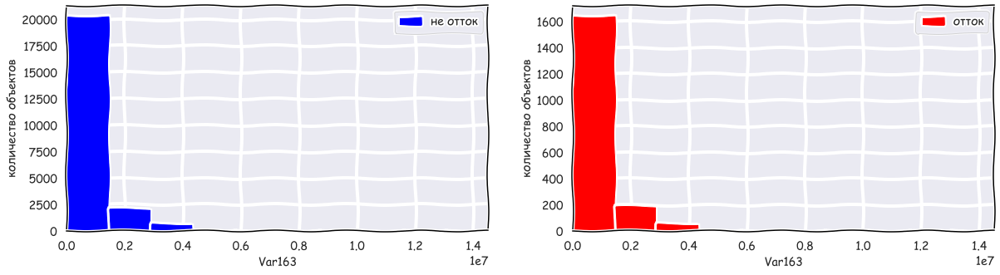

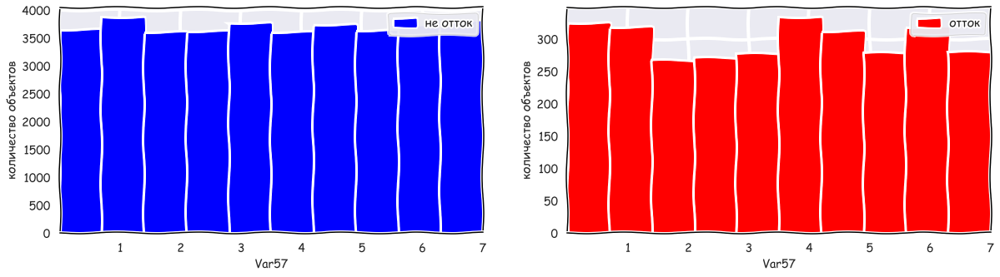

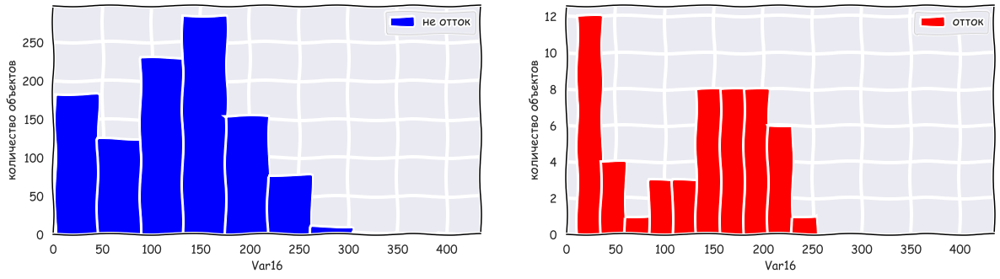

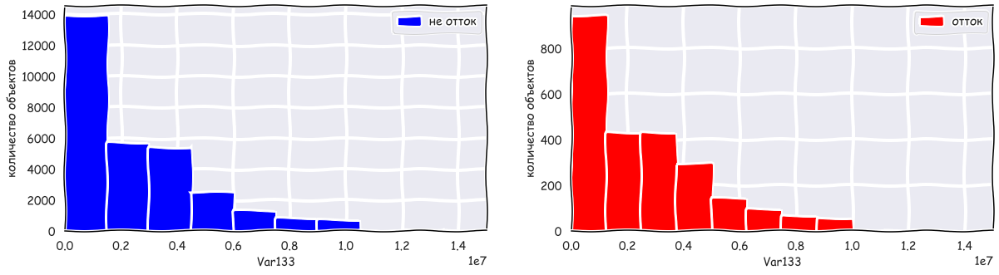

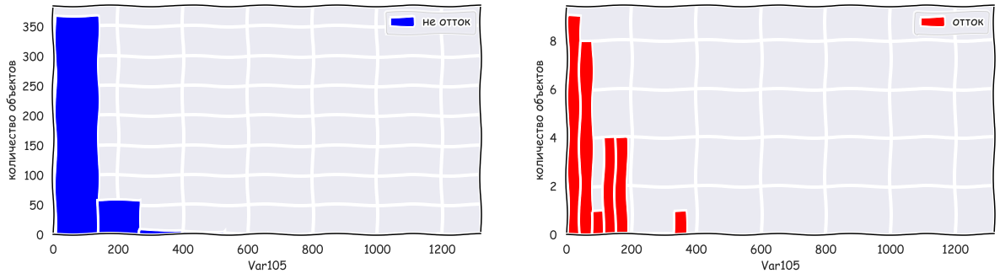

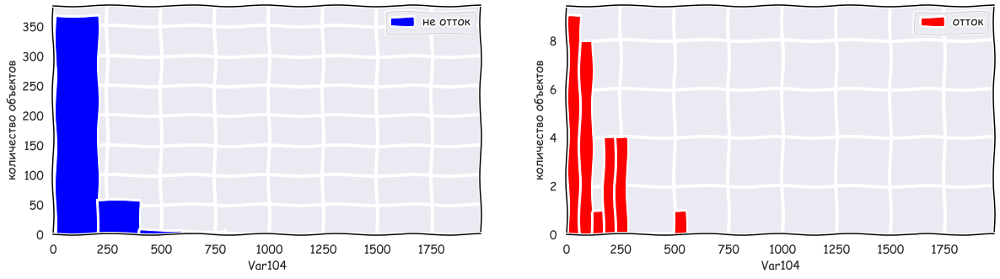

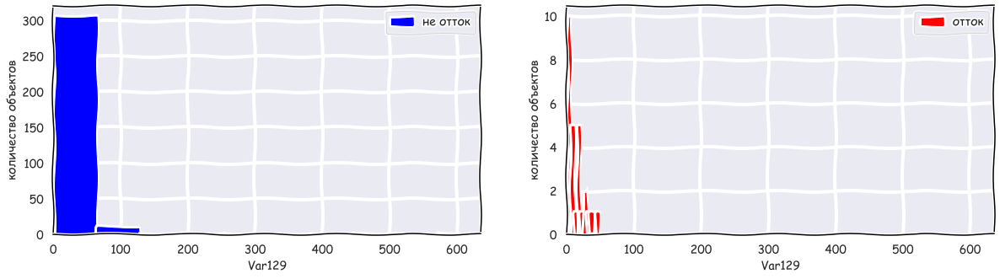

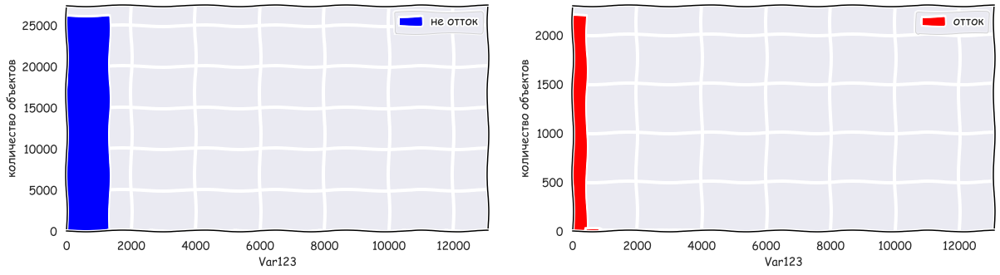

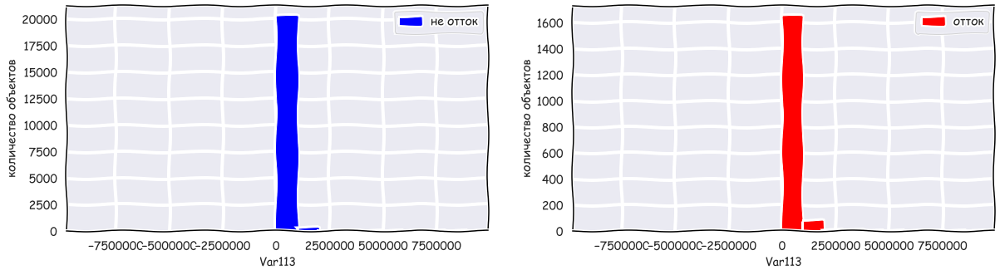

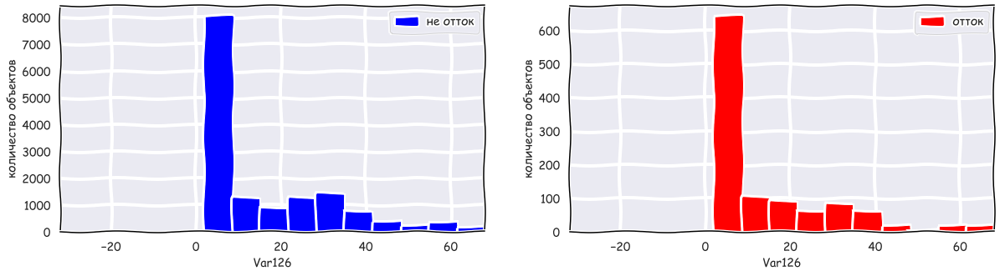

In [50]:
for col in least_important_10_num_fe:
    two_hists(data[col],data['target'],nonzero=True)

Анализ гистограмм показывает, что, в основном, распределения указанных признаков по классам почти идентичны, поэтому они и наименее значимы. Исследуем поподробнее признаки 123 и 113.

C:\Users\artem\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  
C:\Users\artem\Anaconda3\lib\site-packages\ipykernel_launcher.py:2: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  


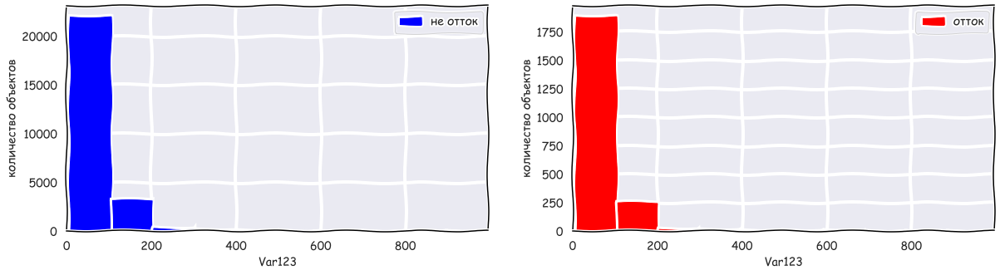

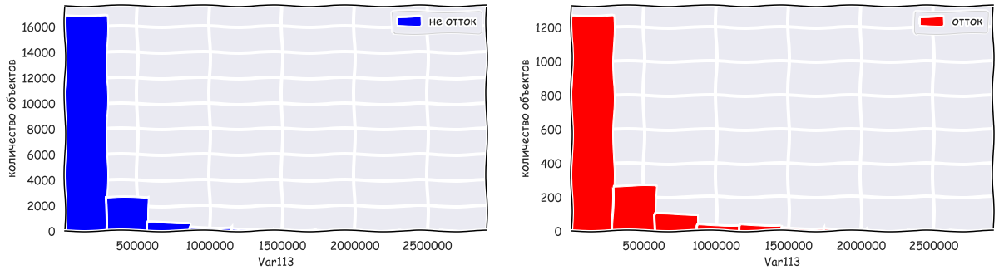

In [51]:
two_hists(data[data.Var123<1000].Var123,data[data.Var123<1000].target,nonzero=True)
two_hists(data[data.Var113<3e6][data.Var113>0].Var113,data[data.Var113<3e6][data.Var113>0].target,nonzero=True)

Данные признаки практически бесполезны.

['Var163', 'Var16']: No real objects in these coords!
['Var163', 'Var105']: No real objects in these coords!
['Var163', 'Var104']: No real objects in these coords!
['Var163', 'Var129']: No real objects in these coords!
['Var16', 'Var133']: No real objects in these coords!
['Var16', 'Var105']: No real objects in these coords!
['Var16', 'Var104']: No real objects in these coords!
['Var16', 'Var129']: No real objects in these coords!
['Var16', 'Var123']: No real objects in these coords!
['Var133', 'Var105']: No real objects in these coords!
['Var133', 'Var104']: No real objects in these coords!
['Var133', 'Var129']: No real objects in these coords!
['Var105', 'Var129']: No real objects in these coords!
['Var105', 'Var123']: No real objects in these coords!
['Var104', 'Var129']: No real objects in these coords!
['Var104', 'Var123']: No real objects in these coords!
['Var129', 'Var123']: No real objects in these coords!


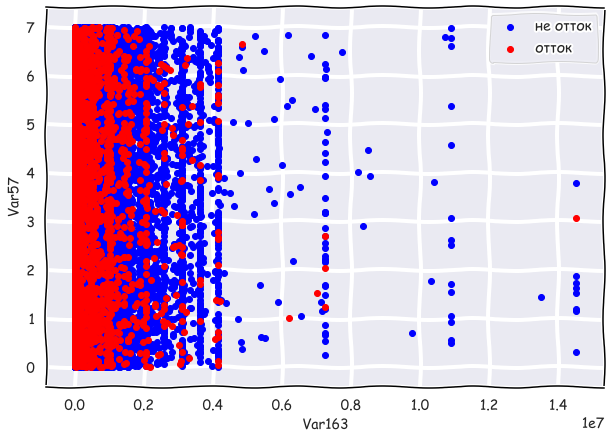

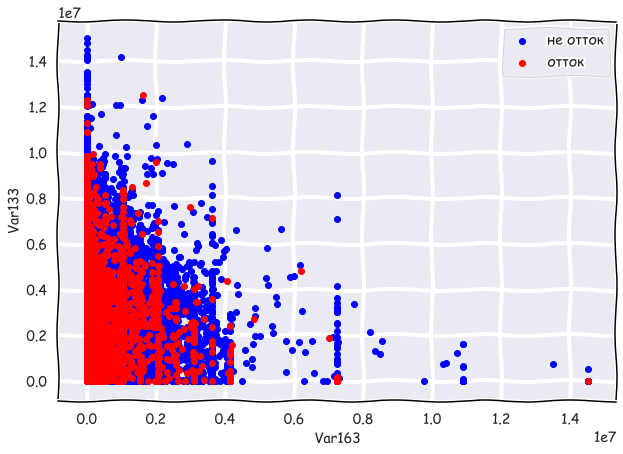

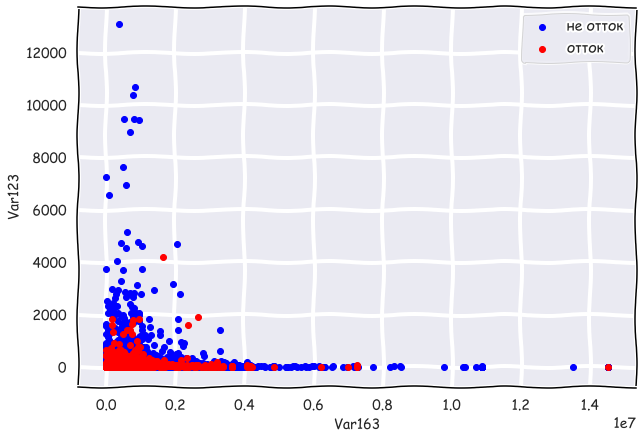

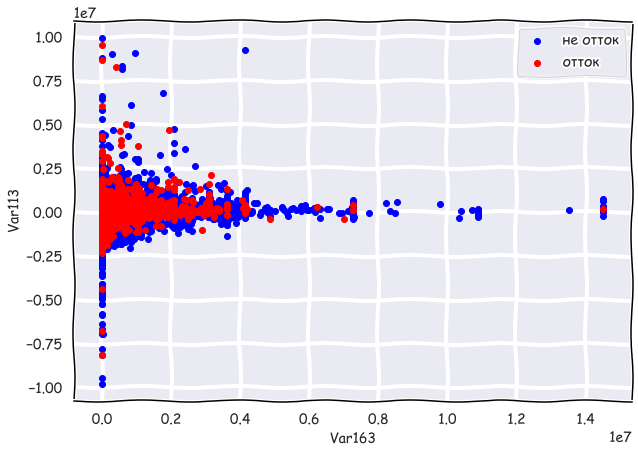

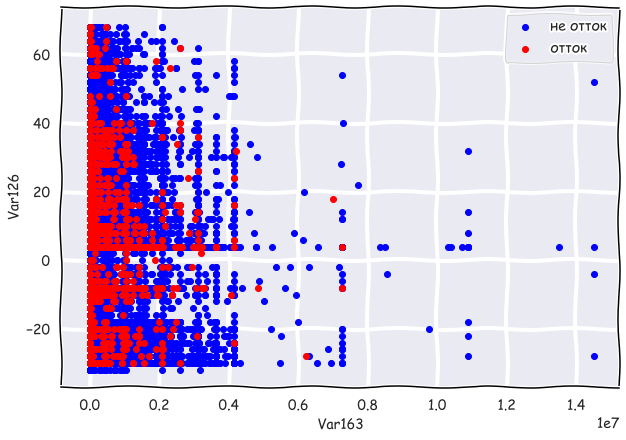

...

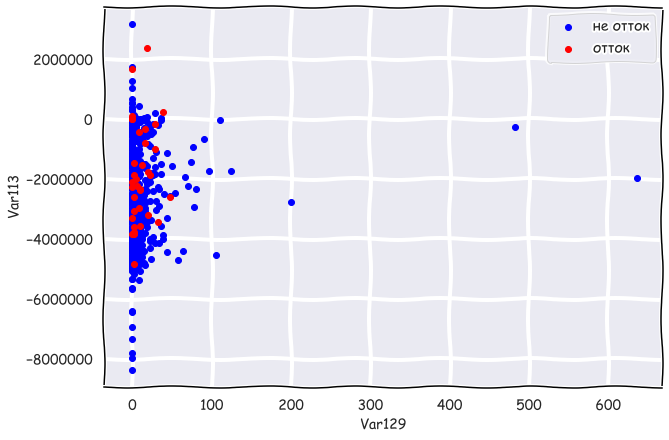

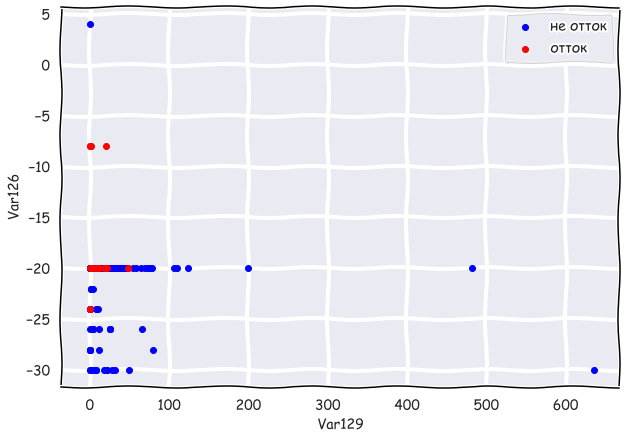

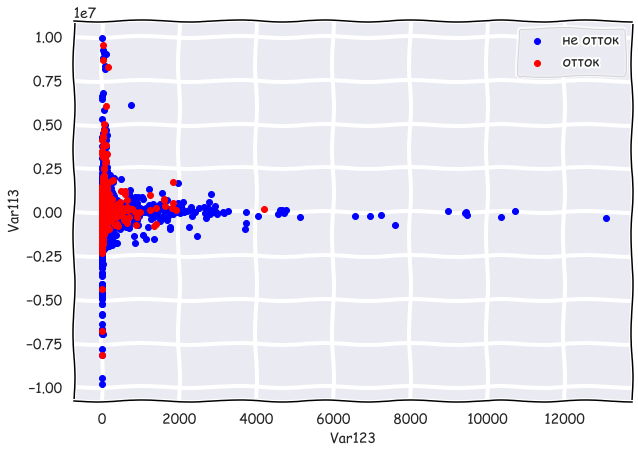

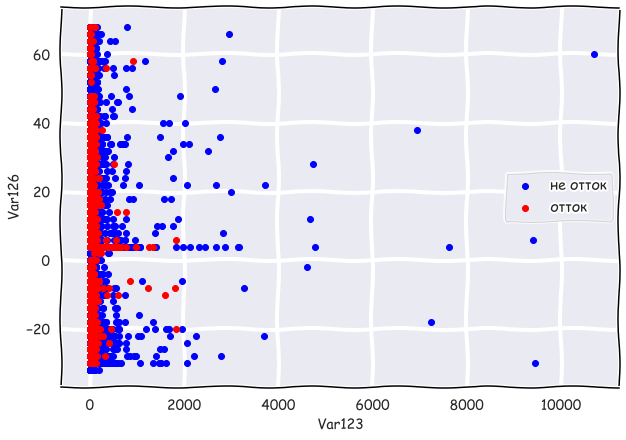

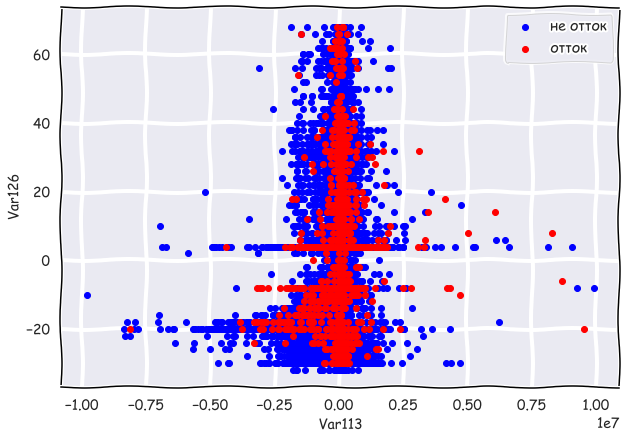

In [52]:
for (col1,col2) in itertools.combinations(least_important_10_num_fe,2):
    scatter_two_classes(fe1 = data[col1],fe2 = data[col2], y=data.target)

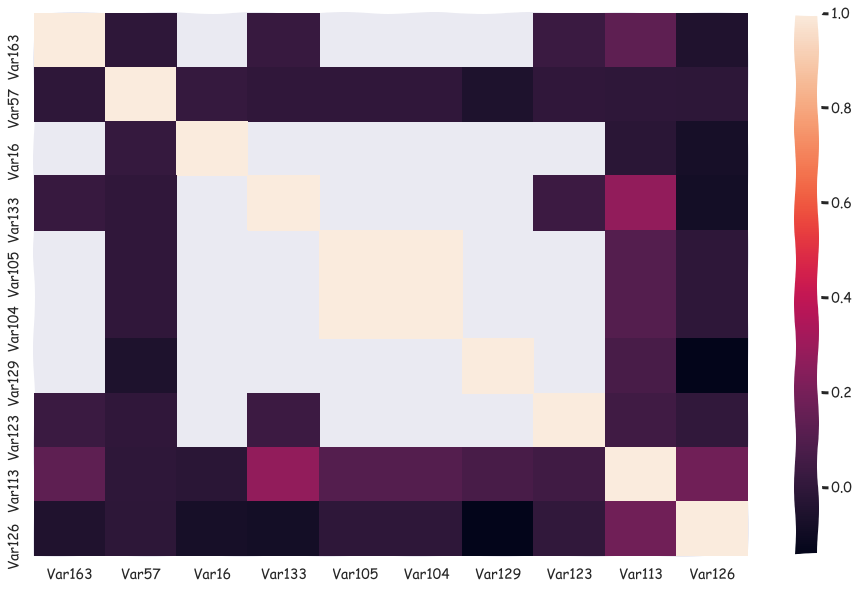

In [53]:
plt.figure(figsize=(16,10))
with plt.xkcd():
    sns.heatmap(data[least_important_10_num_fe].corr(method='pearson'));

['Var163', 'Var16']: No real objects in these coords!
['Var163', 'Var105']: No real objects in these coords!
['Var163', 'Var104']: No real objects in these coords!
['Var163', 'Var129']: No real objects in these coords!
['Var16', 'Var133']: No real objects in these coords!
['Var16', 'Var105']: No real objects in these coords!
['Var16', 'Var104']: No real objects in these coords!
['Var16', 'Var129']: No real objects in these coords!
['Var16', 'Var123']: No real objects in these coords!
['Var133', 'Var105']: No real objects in these coords!
['Var133', 'Var104']: No real objects in these coords!
['Var133', 'Var129']: No real objects in these coords!
['Var105', 'Var129']: No real objects in these coords!
['Var105', 'Var123']: No real objects in these coords!
['Var104', 'Var129']: No real objects in these coords!
['Var104', 'Var123']: No real objects in these coords!
['Var129', 'Var123']: No real objects in these coords!


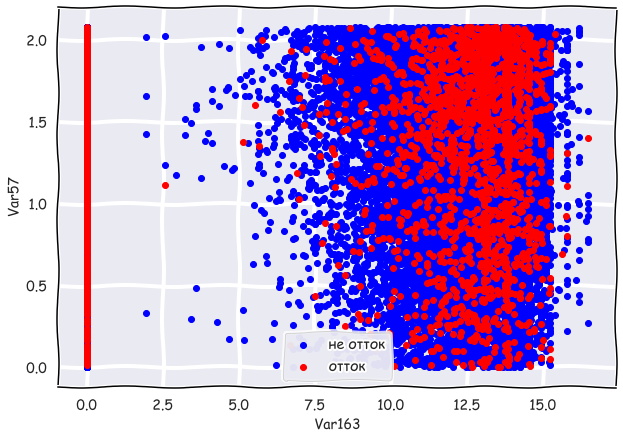

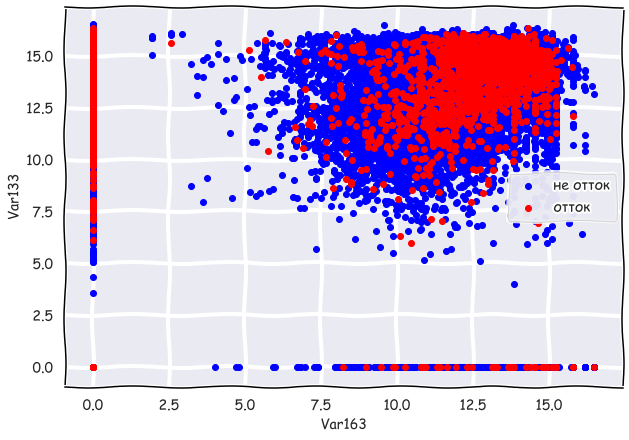

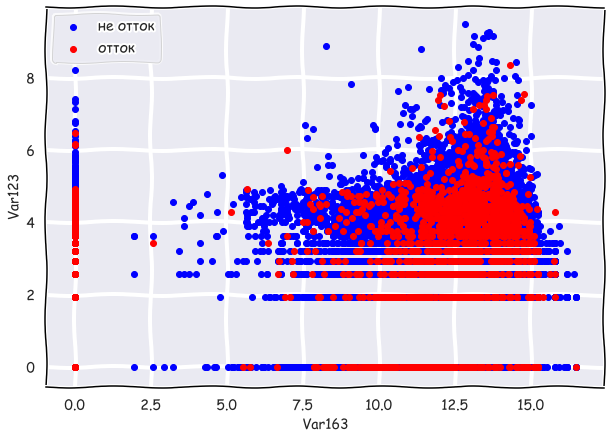

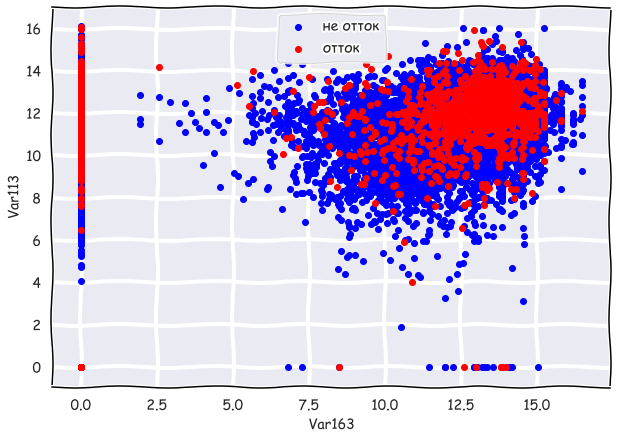

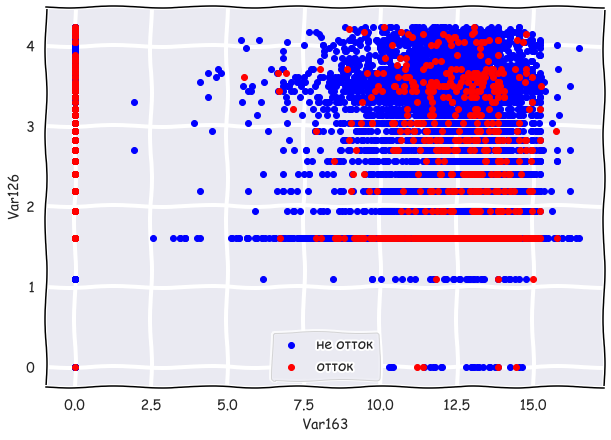

...

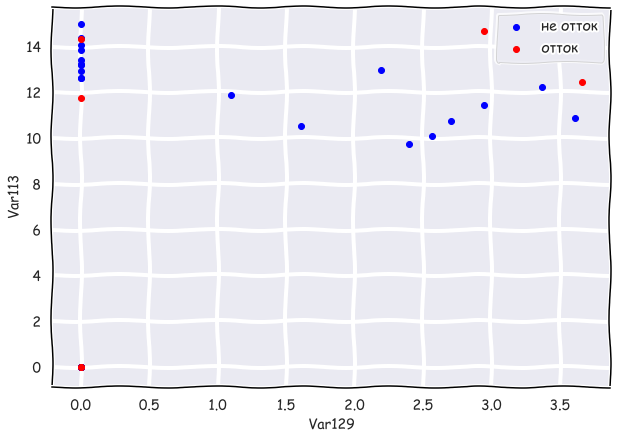

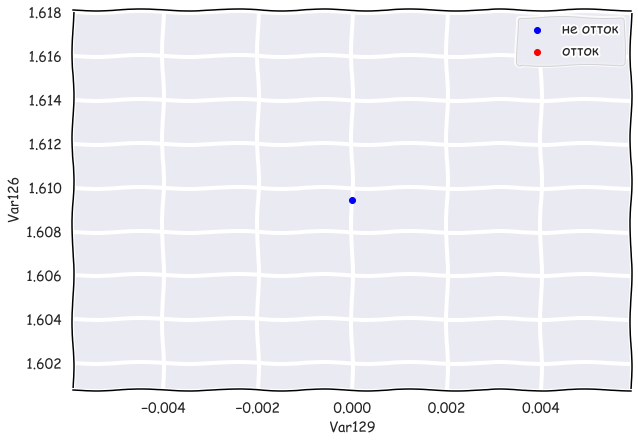

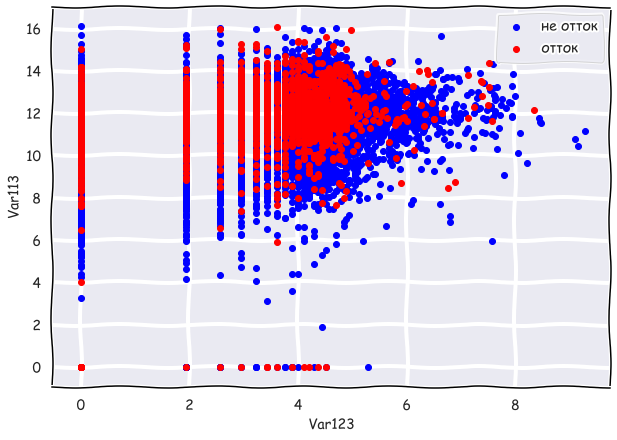

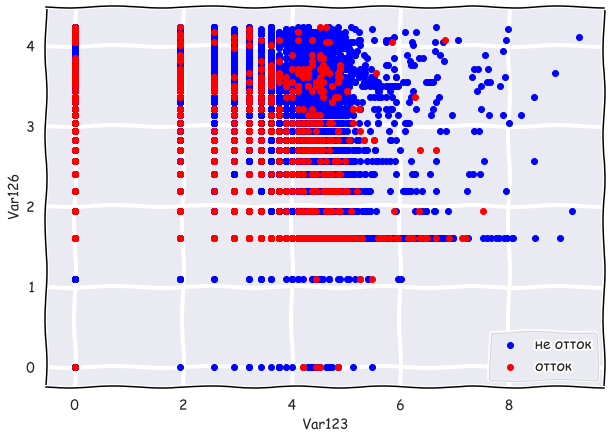

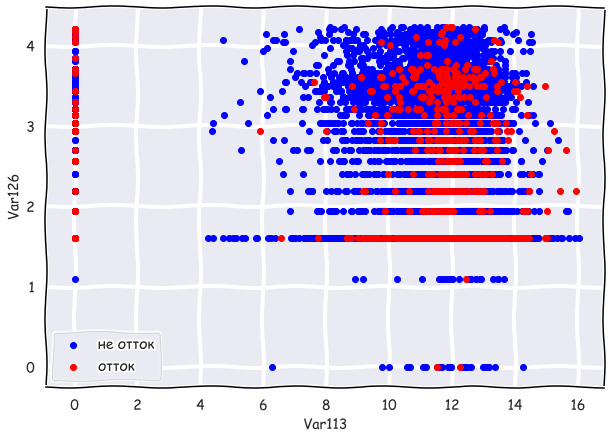

In [54]:
for (col1,col2) in itertools.combinations(least_important_10_num_fe,2):
    scatter_two_classes(fe1 = data[col1],fe2 = data[col2], y=data.target,log1=True,log2=True)

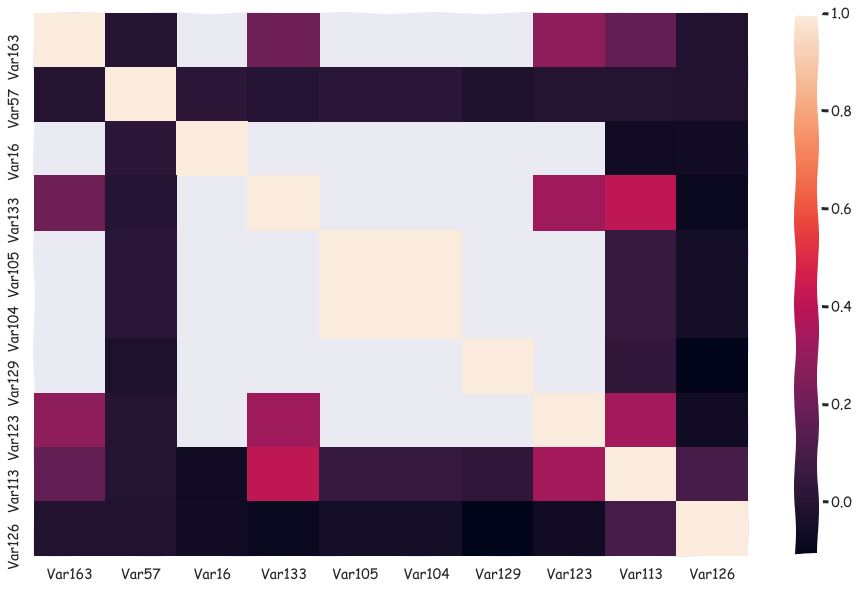

In [55]:
plt.figure(figsize=(16,10))
with plt.xkcd():
    sns.heatmap(data[least_important_10_num_fe].corr(method='spearman'));

Анализ диаграмм показывает наличие множественных корреляций, при этом признаки 104, 105 практически совпадают. При этом видно, почему признаки менее всего коррелируют с целевой переменной, в основном, их распределения не сильно зависят от класса.

Из данных признаков полезным, вероятно, является только 16, бесполезны признаки 163, 57,133,126,123,113.

7\. Посмотрите на категориальные переменные: постройте и сравните гистограммы значений категориальных переменных для разных классов.

In [56]:
def two_hists_cat(col,y,max_bars = 30):
    fe_name = col.name
    num_unique =np.unique(np.array(col.dropna(),dtype=str)).shape[0]
    df = pd.DataFrame(np.vstack([col,y]).T,columns=[fe_name,'target']).dropna() 
    df[fe_name] = df[fe_name].astype('str')
    
    values = df[fe_name].value_counts().index[:max_bars]    
    with plt.xkcd(): 
        fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(20, 5))                       
                
        for idx, (cls, sub_df) in  enumerate(df.groupby('target')):
            ax = axes[idx]
            
            x = sub_df[fe_name].value_counts()
            heights = [x[val] if val in x else 0 for val in values]           
            ax.bar(values, heights,color=color_dic[cls])
            
            ax.set_xticklabels(labels = values, rotation = 90)                 
            ax.set(xlabel=fe_name,ylabel='количество объектов')
            ax.grid(True)
            ax.legend([lbl_dic[cls]]);    


Wall time: 23.7 s


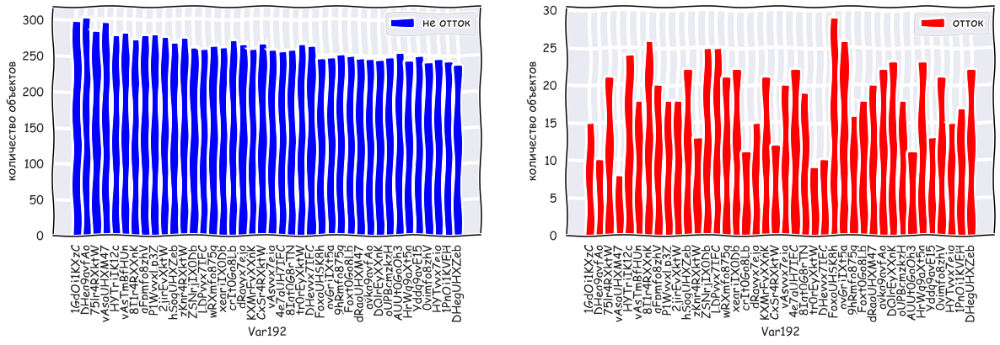

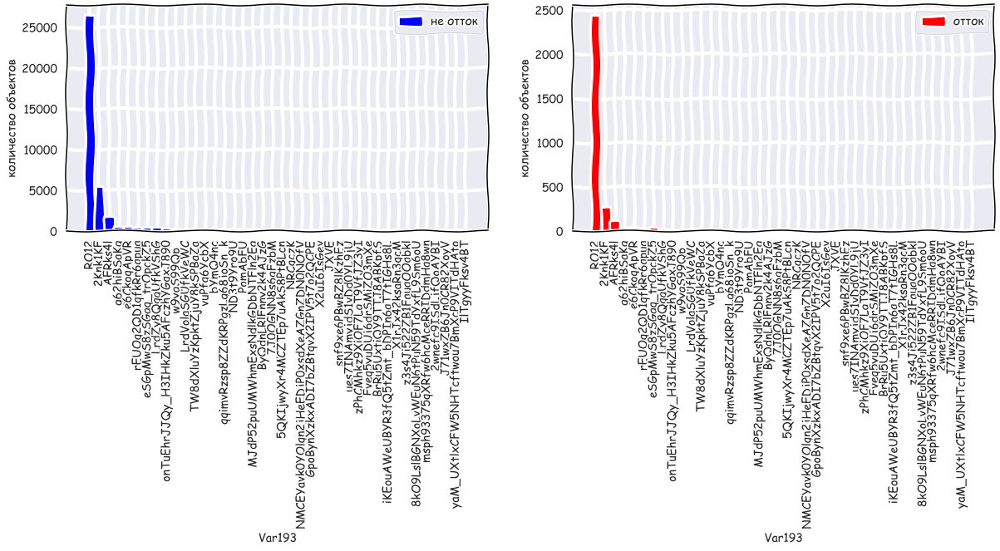

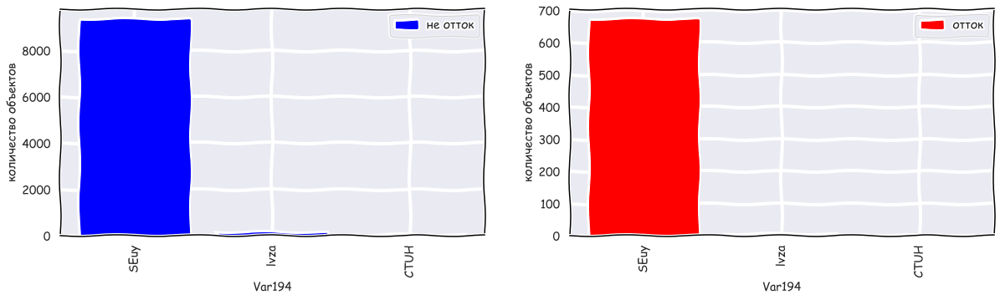

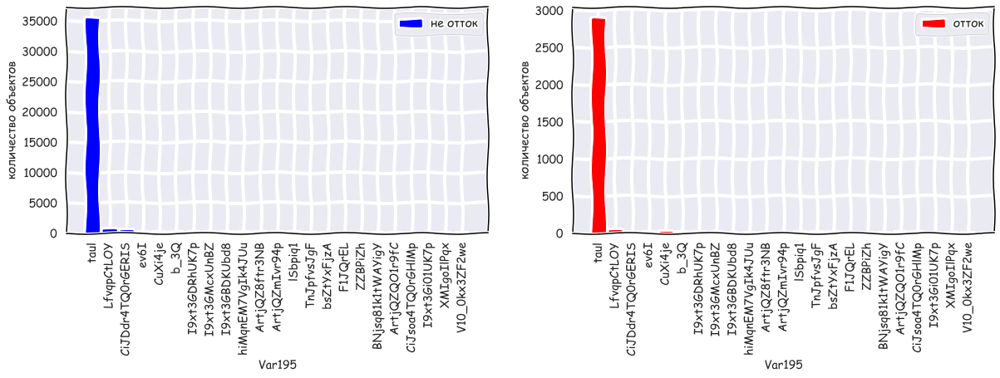

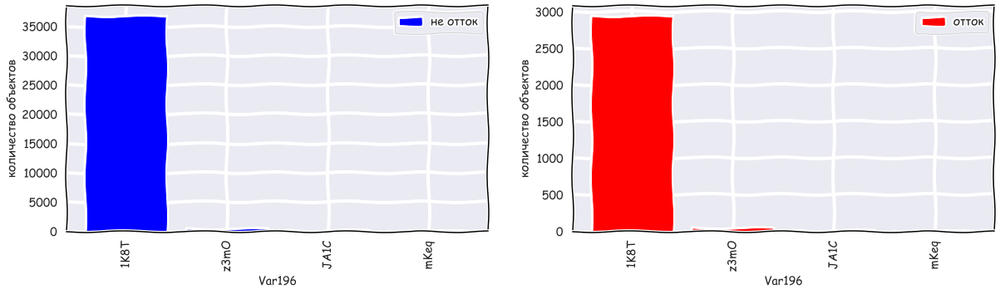

...

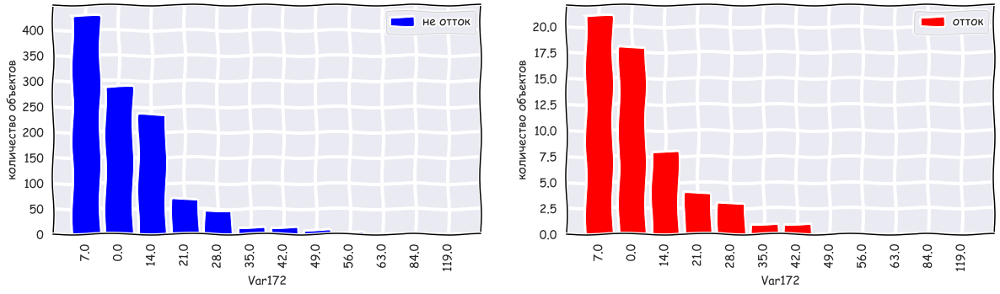

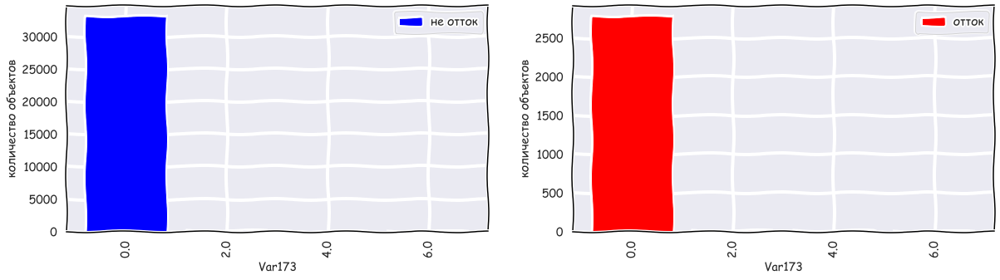

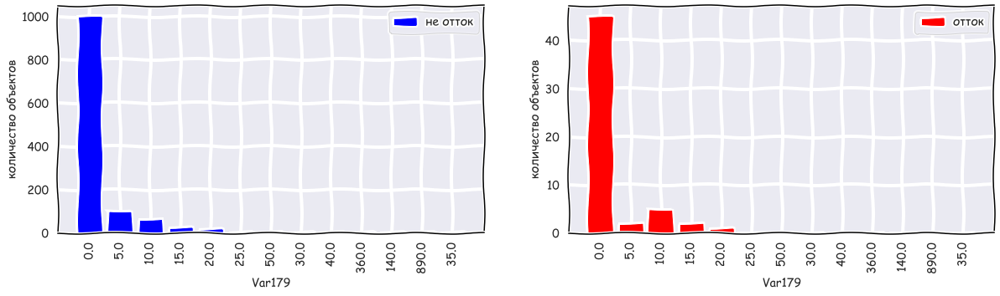

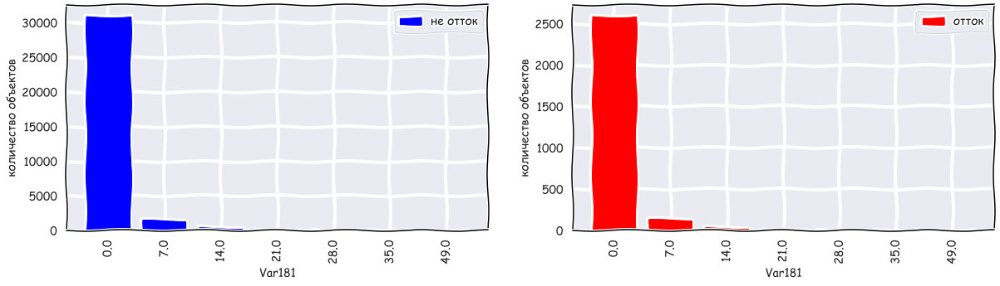

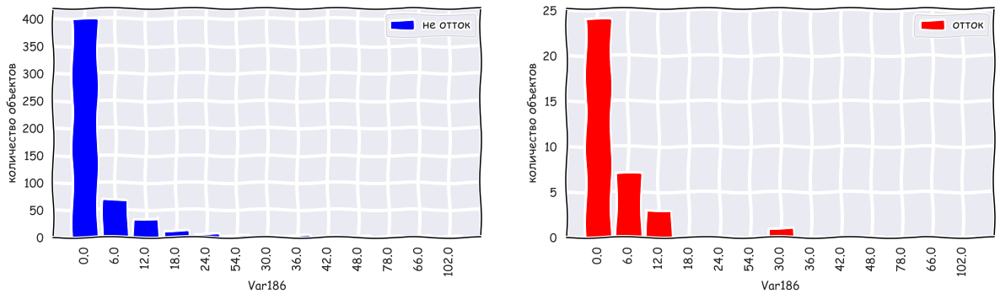

In [57]:
%%time
for col in col_cat:
    two_hists_cat(data[col],data['target'],40)

Из анализа гистограмм, можно сказать, что, вероятно, полезны признаки 192, 199, 200, 202, 214, 218, 225, 7, 30, 82, 87, 152, 172, бесполезными, предположительно, являются признаки 193, 194, 195, 196, 197, 201, 203, 206, 207, 210, 211, 219, 221, 223, 228, 229, 2, 4, 11, 26, 27, 29, 35, 44, 49, 65, 67, 90, 93, 100, 116, 122, 132, 138, 143, 155, 159, 161, 173, 181.

При этом можно заметить, что то признаков по критерию хи-квадрат практически не вошли в число потенциально полезных признаков. Причина здесь в том, что V Крамера для таких признаков не превосходил 0.1 (что означает очень слабая взаимосвязь), при этом критерий не был применим для признаков с большим количеством значений, который, кстати, вошли в перечень полезных.

8. Проанализируйте полученные результаты:
    * Какие выводы вы можете сделать? Заметили ли вы какие-нибудь интересные закономерности?
    * На основании полученных изображений и таблиц, предположите, какие переменные окажут наибольшее влияние (вклад) в модель?
    * Какие переменные на ваш взгляд окажутся наименее полезными, шумовыми?
    * Как вы думаете, окажется ли отбор признаков полезным для построения модели?

**Выводы по результатам предварительного анализа данных:**
1. Прежде всего, выборка крайне несбалансированная (класс оттока существенно меньше), а в данных очень много пустых ячеек, при этом среди заполненных превалируют числа(после первичной селекции при данном подходе - 117 числовых признаков, 90 категориальных).
2. Присутствуют много числовых признаков с ограниченным количеством значений - отнесены к категориальным.
3. Наиболее информативными, вероятно, являются признаки 131,77, 124,177,98,154, 36,16, 192, 199, 200, 202, 214, 218, 225, 7, 30, 82, 87, 152, 172.
4. Наименее полезными,вероятно, окажутся признаки 74,23,107,157,57,24,25, 163, 57,133,126,123,113, 193, 194, 195, 196, 197, 201, 203, 206, 207, 210, 211, 219, 221, 223, 228, 229, 2, 4, 11, 26, 27, 29, 35, 44, 49, 65, 67, 90, 93, 100, 116, 122, 132, 138, 143, 155, 159, 161, 173, 181.
5. В данных присутствует корреляция между некоторыми числовыми признаками (104, 105),(129, 66, 9),(131 и 50), (177 и 114), (23,107,157 и 166), (77 и 12), (24,25) и (136,154). Некоторые из них представляется целесообразным исключить из рассмотрения для предотвращения линейной зависимости, при этом часть их них уже отнесена к бесполезным вследствие идентичности распределений по классам.
6. Также есть желание убрать признаки, в которых превалирует (более 90%) одно значение как малоинформативные, но в нашем случае задача крайне несбалансирована, поэтому остальные значения, которых мало, могут характеризовать меньший класс.
7. На мой взгляд, отбор признаков окажется полезным для модели, поскольку может улучшить качество алгоритма (исключит настройку на шум) и его скоростные характеристики(чем меньше размерность признакового пространства, тем меньше весов нужно искать).
8. Очень важным выводом является то, что оценка корреляции вещественных признаков с целевой переменной с помощь разности математических ожиданий иногда настраивается на выбросы, возможно, лучше использовать разность медиан.
9. Также важно заметить, что такое большое количество инфографики в одной тетради не очень полезно для моего комьютера.

